# A comparison of the performance of Koopman versus the Vanilla benchmark
Trained on 11 years of data starting in 2005. Then a 52 day gap. Then tested for one month. This is repeated for every other month of the year and each zone for a total of 6 * 9 = 54.

In [1]:
import torch
import random
import numpy as np
import pandas as pd
import numpy.matlib
import matplotlib.pyplot as plt
%matplotlib inline
from datetime import datetime
from scipy.stats import norm, skewnorm, skew

In [2]:
seed = 633

print("[ Using Seed : ", seed, " ]")

torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.cuda.manual_seed(seed)
numpy.random.seed(seed)
random.seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

[ Using Seed :  633  ]


In [3]:
from koopman_probabilistic import *
from model_objs import *
import vanilla_benchmark

## Pinball Loss

In [4]:
def skew_pinball_loss(data, mus, sigmas, alphas, quantiles=range(10, 100, 10)):
    loss = 0
    for i in range(len(data)):
        for q in quantiles:
            q = q / 100
            quant_pred = skewnorm.ppf(q, alphas[i], loc=mus[i], scale=sigmas[i])
            if quant_pred > data[i]:
                loss += (quant_pred - data[i]) * (1 - q)
            else:
                loss += (data[i] - quant_pred) * q
    return loss / (len(data) * len(quantiles))

In [5]:
normal_pdf = lambda mu, sigma, x: np.exp(-(x - mu)**2 / (2 * sigma**2))/(np.sqrt(2 * np.pi * sigma**2))

# load data

In [6]:
import json

with open("GEFCom2017\\GEFCom2017-Qual\\GEFCom2017QualAll.json") as f:
    all_data = json.loads(f.read())

In [7]:
dates = np.array(list(map(pd.Timestamp, all_data["ISONE CA"]["Date"])))

In [8]:
test_start_dates = np.array(list(pd.Timestamp(year=2017, month=mo, day=1) for mo in range(1, 13)))
test_starts = list(np.argwhere(dates == date)[0, 0] for date in test_start_dates)
months = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

In [9]:
delay_delta = pd.Timedelta(days=52)
train_end_dates = test_start_dates - delay_delta
train_start_dates = np.array(list(date.replace(year=date.year - 11) for date in train_end_dates))
train_length_deltas = train_end_dates - train_start_dates
pre_lengths = train_length_deltas / 2 # the length of time at the beginning of the trianing period to hide from mu

## Vanilla Benchmark Forecast

ISONE CA
2005-11-10 00:00:00
ISONE CA


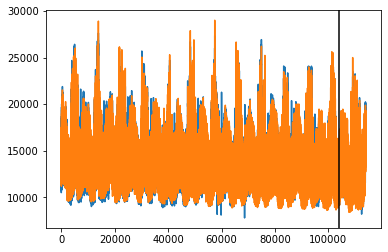

k = 4


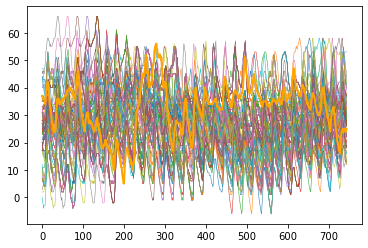

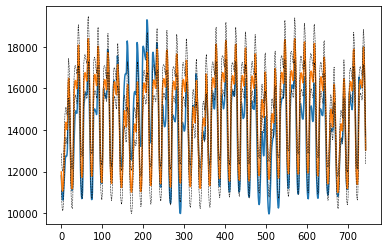

{'ISONE CA': 396.80724510688697}
2005-12-11 00:00:00
ISONE CA


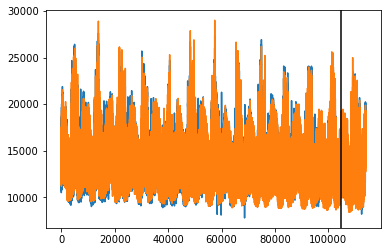

k = 4


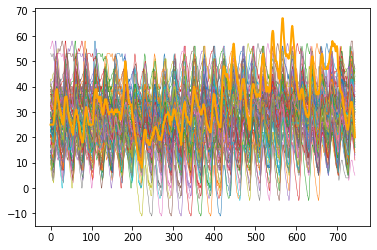

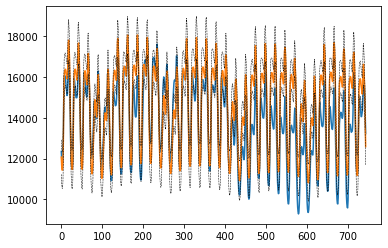

{'ISONE CA': 409.13201995070347}
2006-01-08 00:00:00
ISONE CA


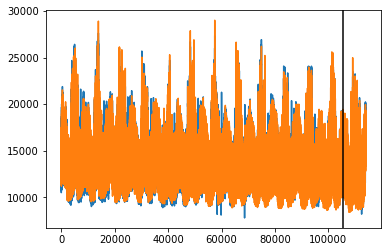

k = 4


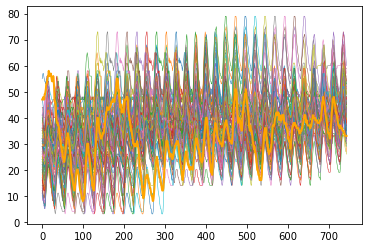

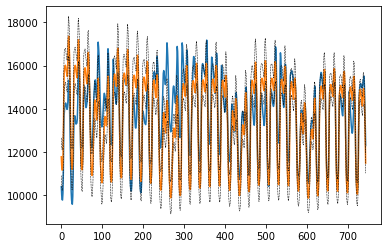

{'ISONE CA': 373.5736890307723}
2006-02-08 00:00:00
ISONE CA


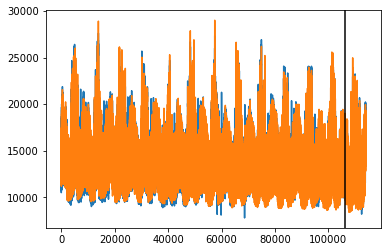

k = 4


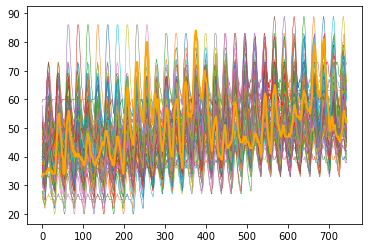

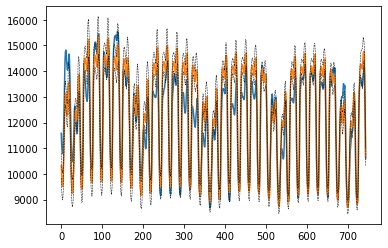

{'ISONE CA': 216.56437790241225}
2006-03-10 00:00:00
ISONE CA


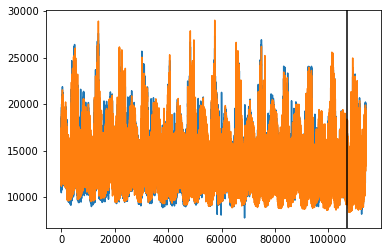

k = 4


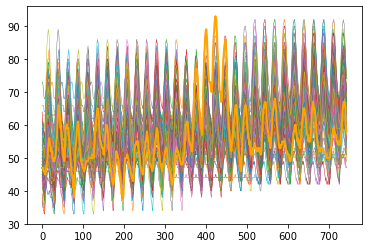

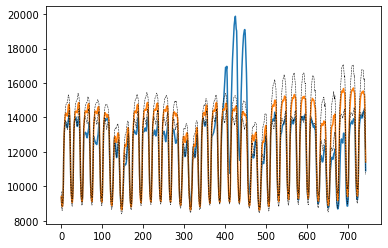

{'ISONE CA': 358.0472823830687}
2006-04-10 00:00:00
ISONE CA


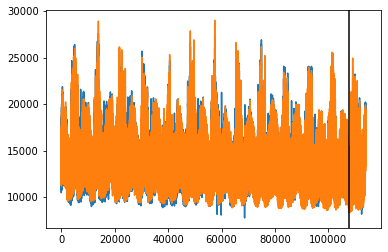

k = 4


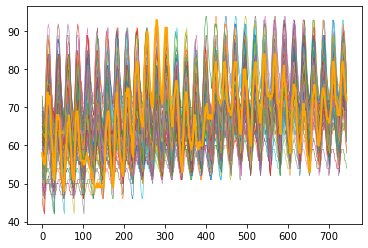

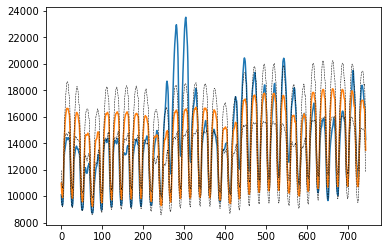

{'ISONE CA': 560.1433664017665}
2006-05-10 00:00:00
ISONE CA


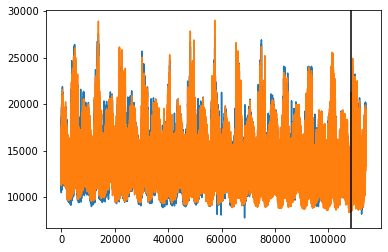

k = 4


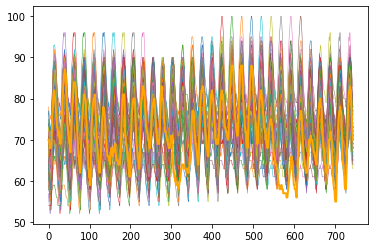

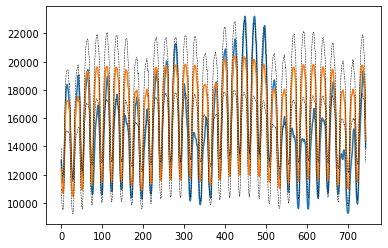

{'ISONE CA': 637.5725866361081}
2006-06-10 00:00:00
ISONE CA


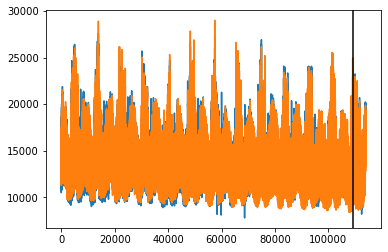

k = 4


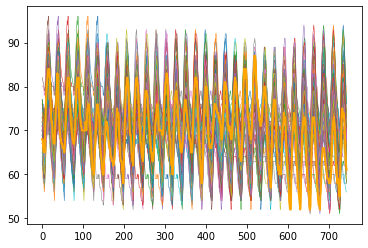

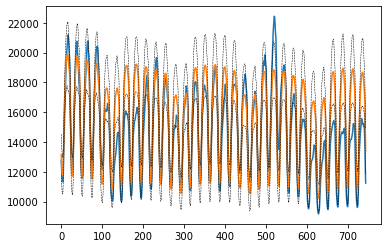

{'ISONE CA': 492.79067317304356}
2006-07-11 00:00:00
ISONE CA


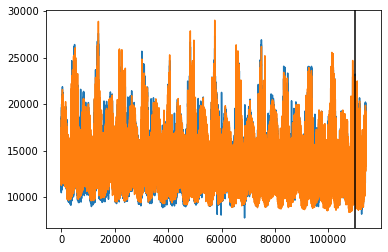

k = 4


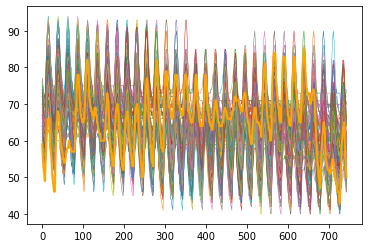

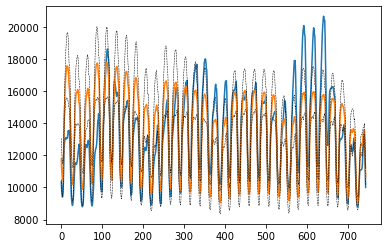

{'ISONE CA': 546.8176847562634}
2006-08-10 00:00:00
ISONE CA


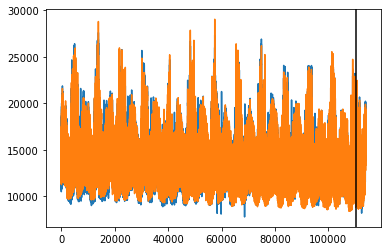

k = 4


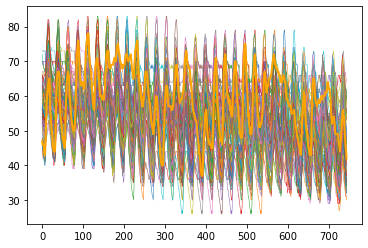

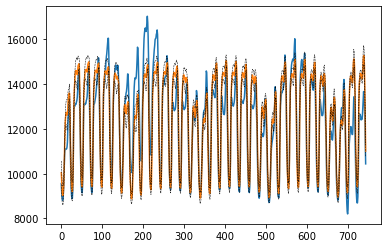

{'ISONE CA': 297.1252275578539}
2006-09-10 00:00:00
ISONE CA


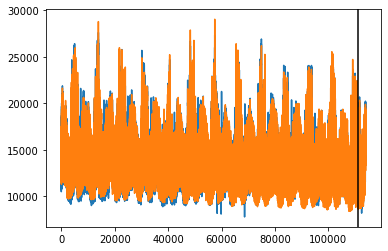

k = 4


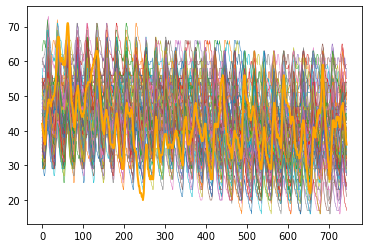

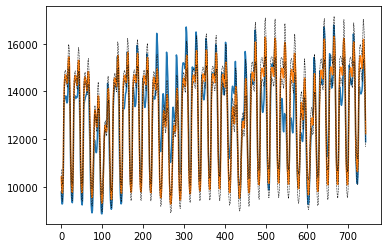

{'ISONE CA': 275.4528671832223}
2006-10-10 00:00:00
ISONE CA


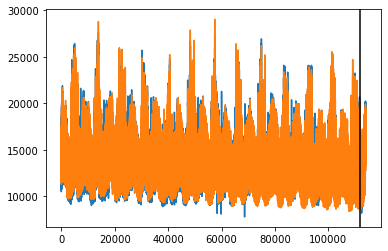

k = 4


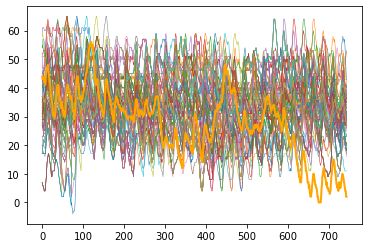

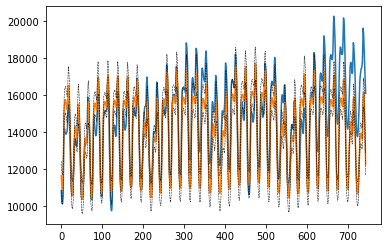

{'ISONE CA': 444.53341320939836}
ME
2005-11-10 00:00:00
ME


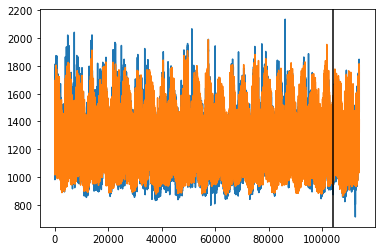

k = 4


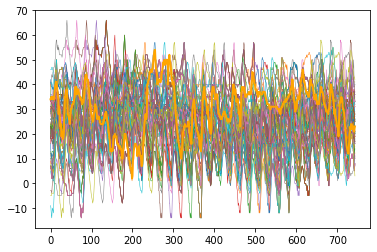

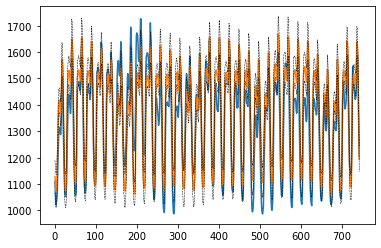

{'ME': 28.415283347371133}
2005-12-11 00:00:00
ME


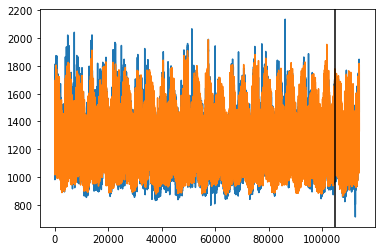

k = 4


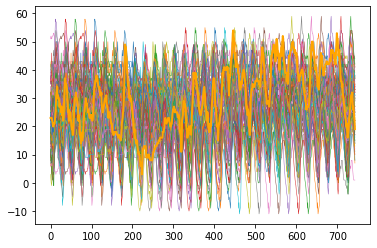

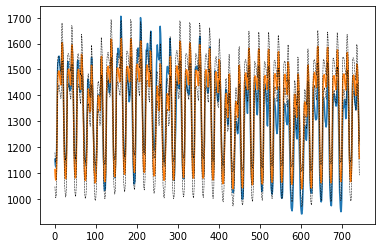

{'ME': 24.285066419107142}
2006-01-08 00:00:00
ME


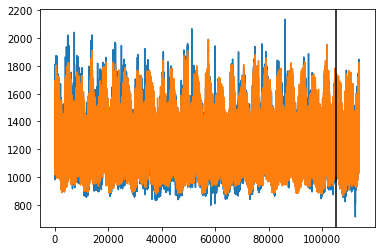

k = 4


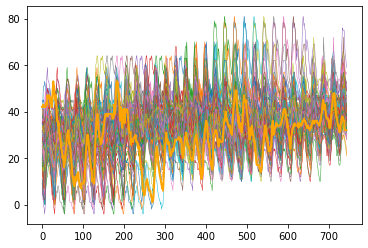

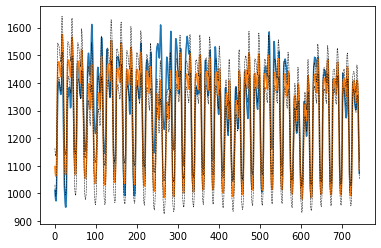

{'ME': 25.37834533302525}
2006-02-08 00:00:00
ME


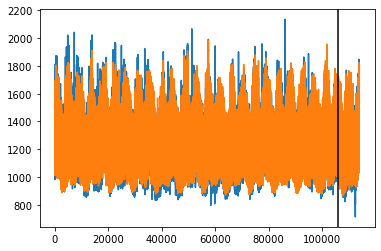

k = 4


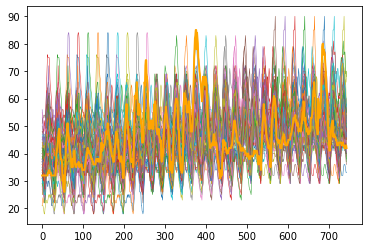

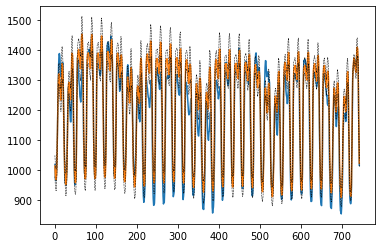

{'ME': 18.13171850954474}
2006-03-10 00:00:00
ME


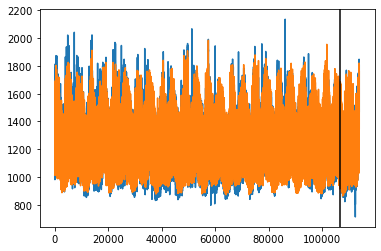

k = 4


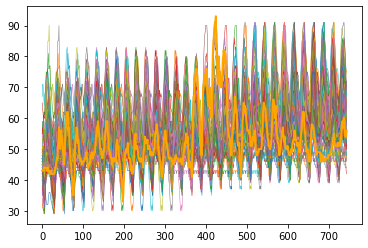

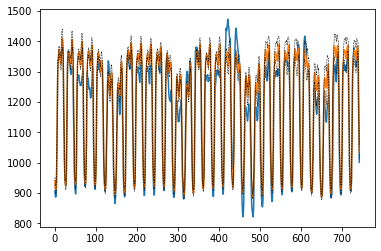

{'ME': 17.12675354981821}
2006-04-10 00:00:00
ME


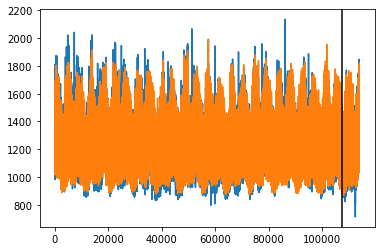

k = 4


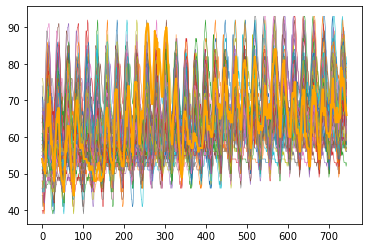

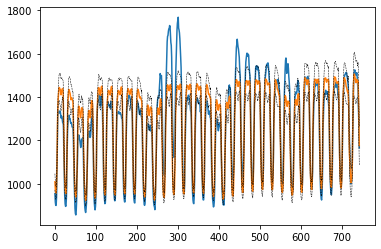

{'ME': 27.557409519537448}
2006-05-10 00:00:00
ME


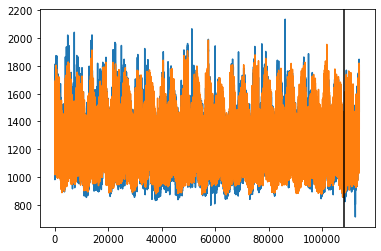

k = 4


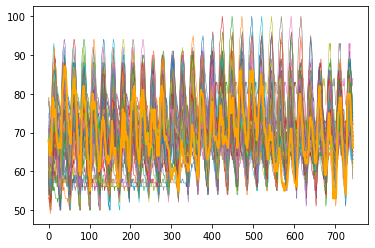

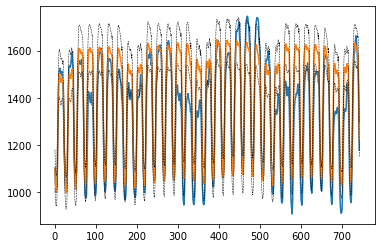

{'ME': 32.32882313921198}
2006-06-10 00:00:00
ME


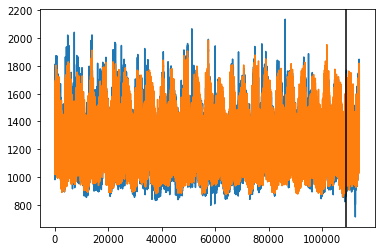

k = 4


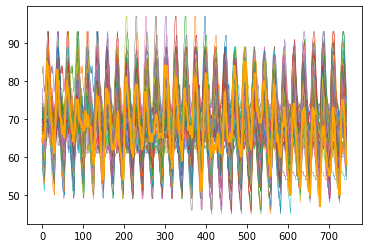

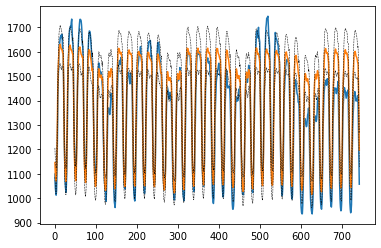

{'ME': 25.501681740200993}
2006-07-11 00:00:00
ME


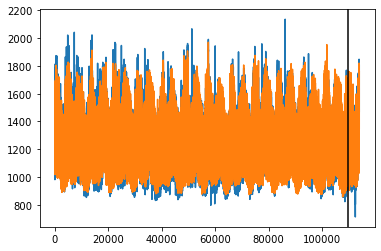

k = 4


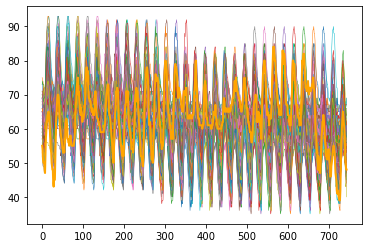

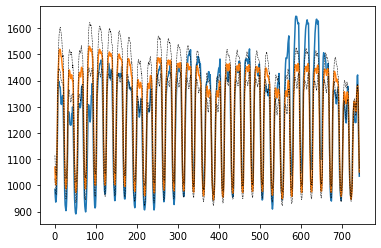

{'ME': 25.138356572177823}
2006-08-10 00:00:00
ME


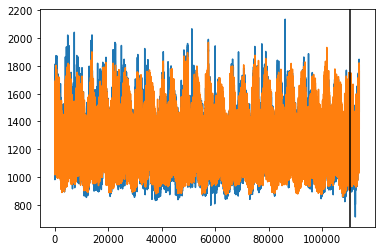

k = 4


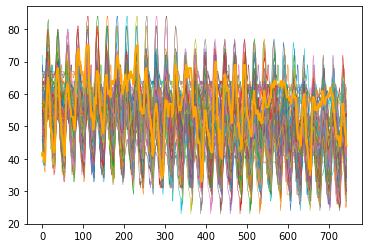

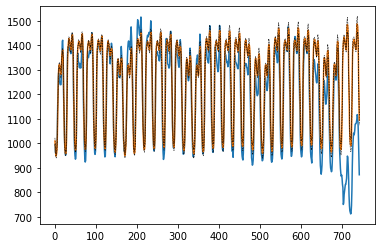

{'ME': 30.640453870158066}
2006-09-10 00:00:00
ME


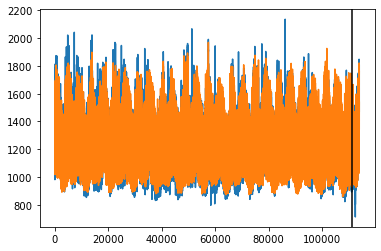

k = 4


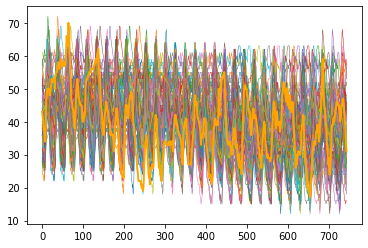

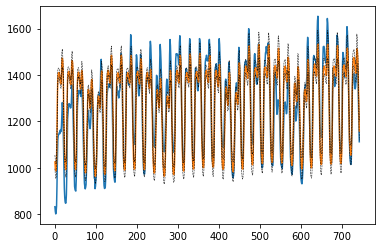

{'ME': 28.221124439927713}
2006-10-10 00:00:00
ME


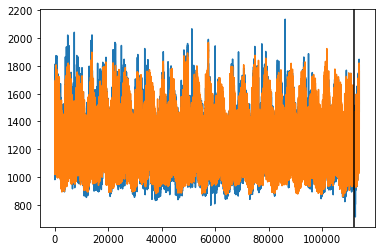

k = 4


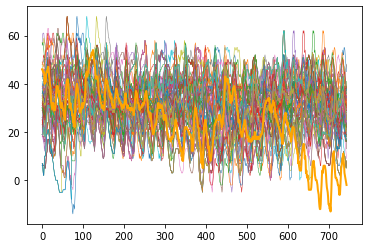

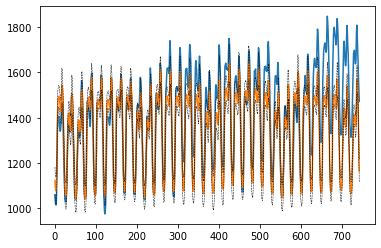

{'ME': 37.533138489271415}
RI
2005-11-10 00:00:00
RI


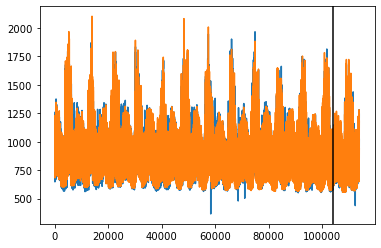

k = 4


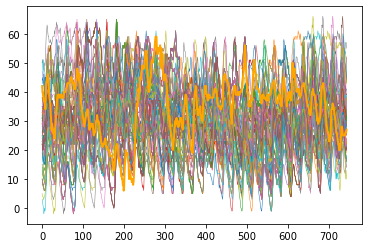

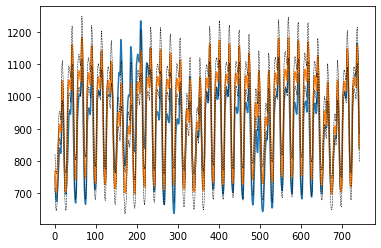

{'RI': 23.931533993033284}
2005-12-11 00:00:00
RI


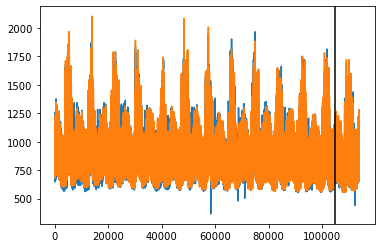

k = 4


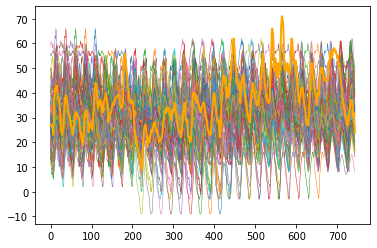

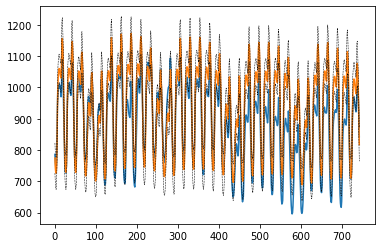

{'RI': 25.973438764561777}
2006-01-08 00:00:00
RI


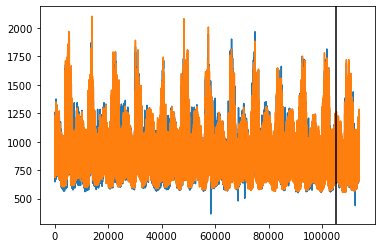

k = 4


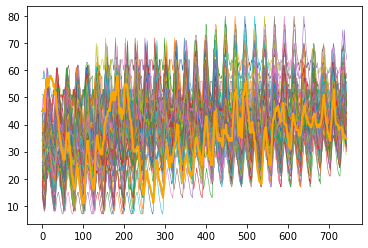

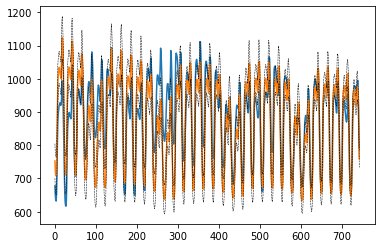

{'RI': 22.776366882964062}
2006-02-08 00:00:00
RI


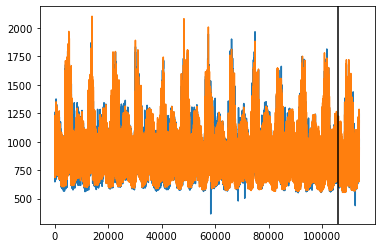

k = 4


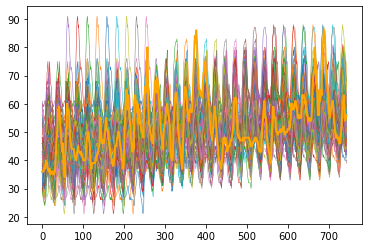

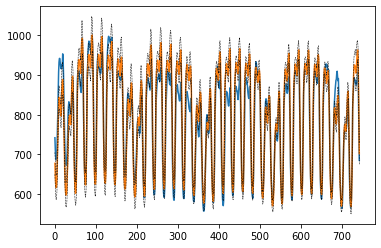

{'RI': 12.621410383342402}
2006-03-10 00:00:00
RI


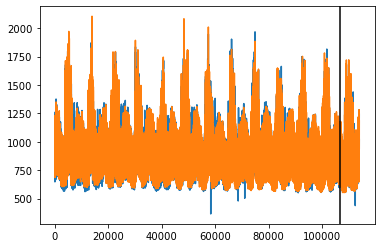

k = 4


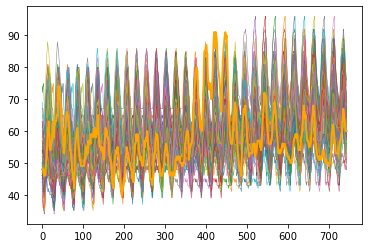

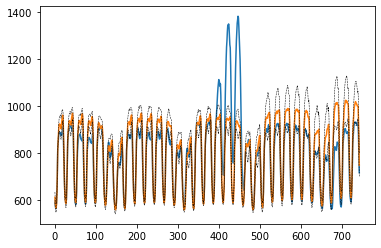

{'RI': 22.181188292396556}
2006-04-10 00:00:00
RI


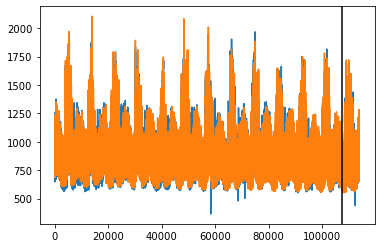

k = 4


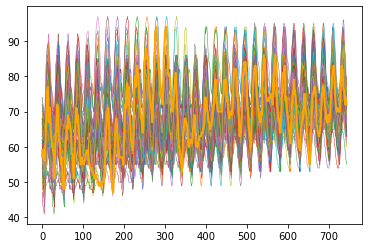

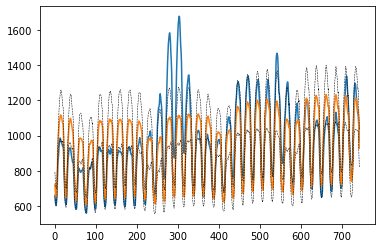

{'RI': 40.184768197183345}
2006-05-10 00:00:00
RI


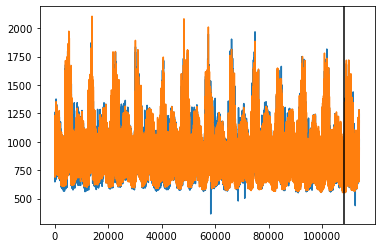

k = 4


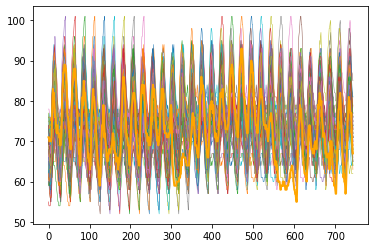

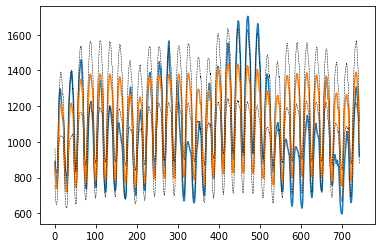

{'RI': 49.48678211986186}
2006-06-10 00:00:00
RI


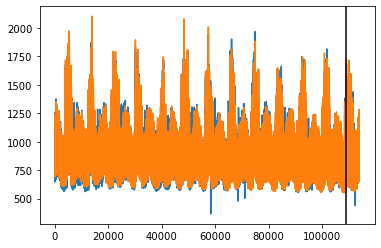

k = 4


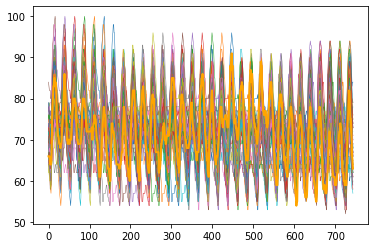

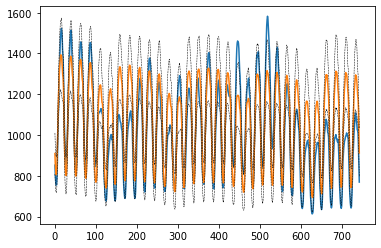

{'RI': 36.72894705010676}
2006-07-11 00:00:00
RI


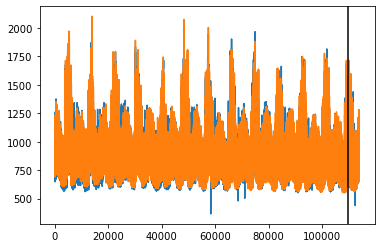

k = 4


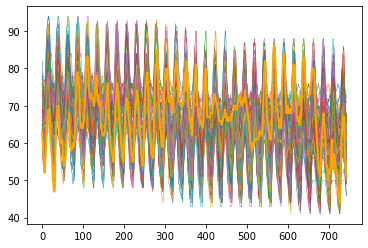

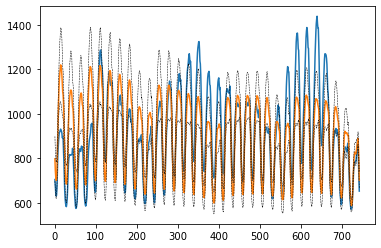

{'RI': 39.95675449533233}
2006-08-10 00:00:00
RI


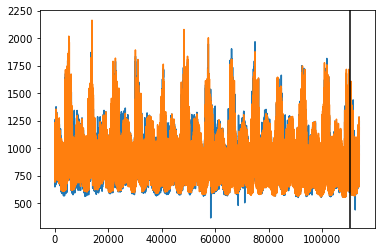

k = 4


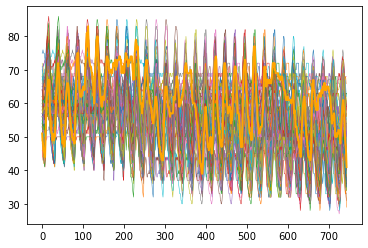

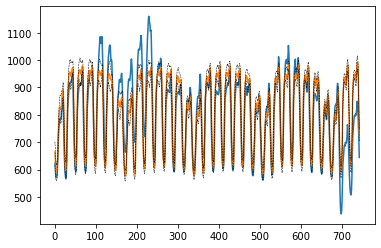

{'RI': 21.063445636986287}
2006-09-10 00:00:00
RI


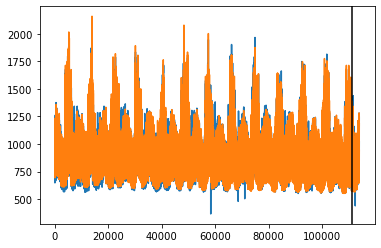

k = 4


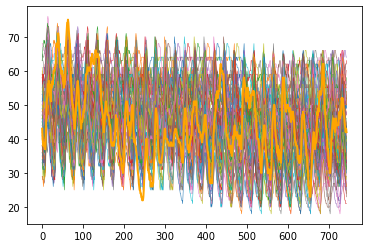

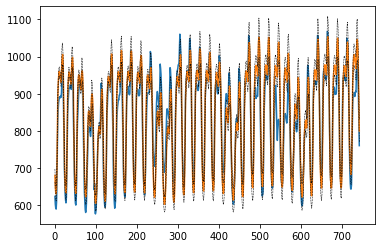

{'RI': 14.912208747014711}
2006-10-10 00:00:00
RI


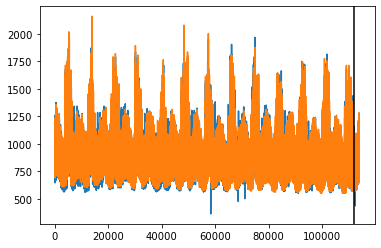

k = 4


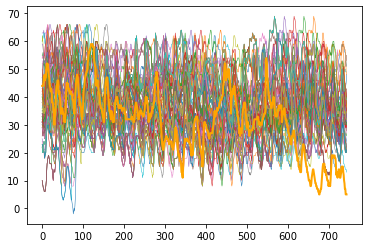

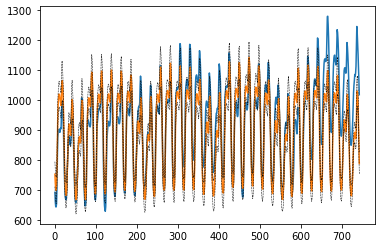

{'RI': 24.64585923060675}
VT
2005-11-10 00:00:00
VT


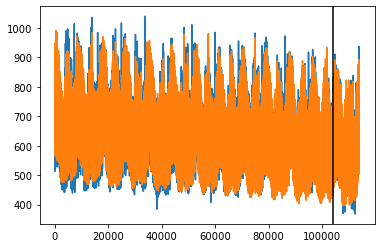

k = 4


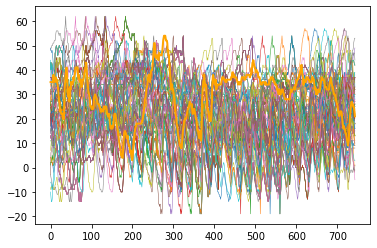

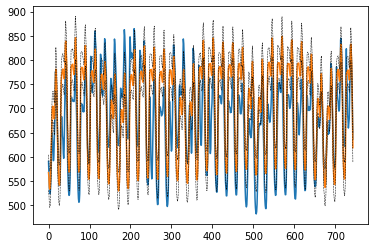

{'VT': 22.959252952672337}
2005-12-11 00:00:00
VT


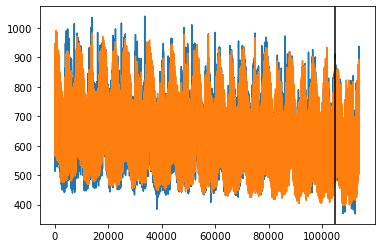

k = 4


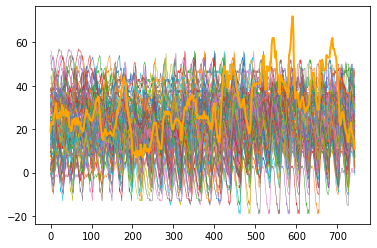

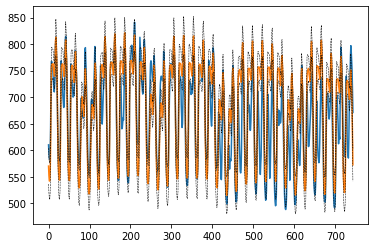

{'VT': 16.490437964962375}
2006-01-08 00:00:00
VT


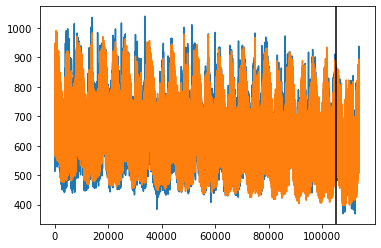

k = 4


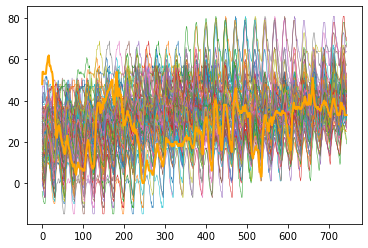

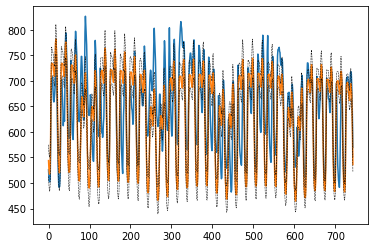

{'VT': 22.68469889021351}
2006-02-08 00:00:00
VT


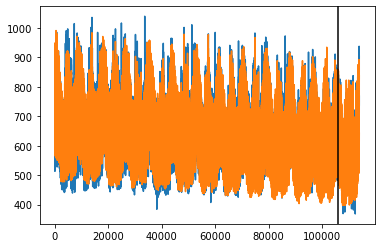

k = 4


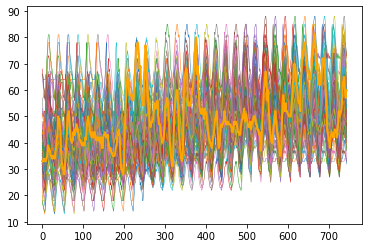

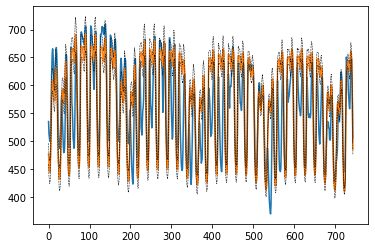

{'VT': 18.741538290194963}
2006-03-10 00:00:00
VT


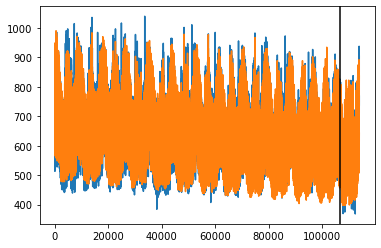

k = 4


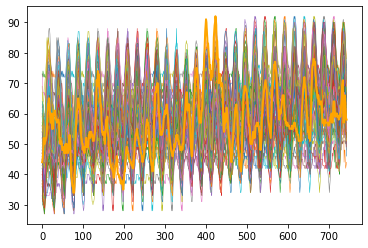

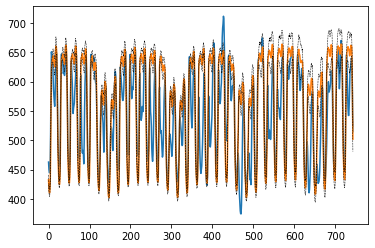

{'VT': 19.900982951282597}
2006-04-10 00:00:00
VT


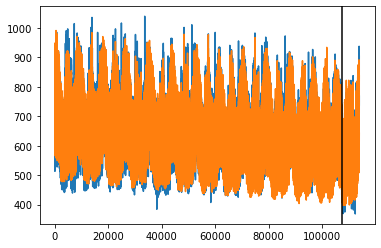

k = 4


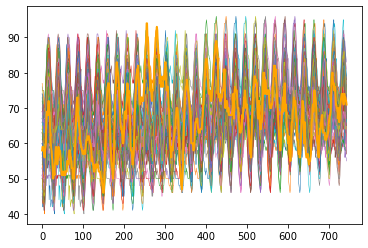

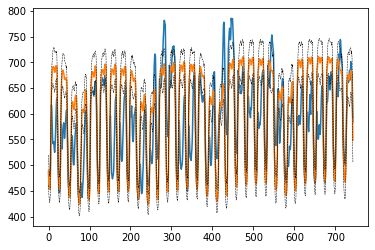

{'VT': 22.81754514086226}
2006-05-10 00:00:00
VT


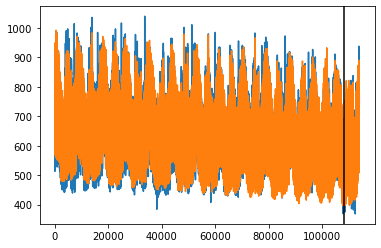

k = 4


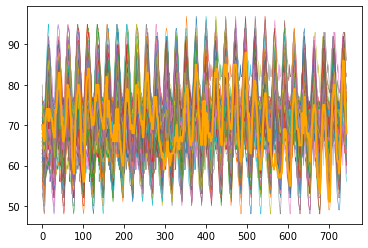

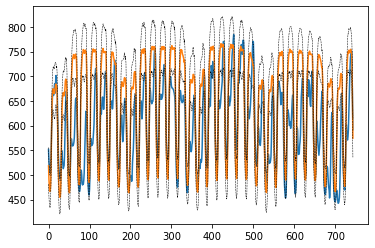

{'VT': 26.19064367998076}
2006-06-10 00:00:00
VT


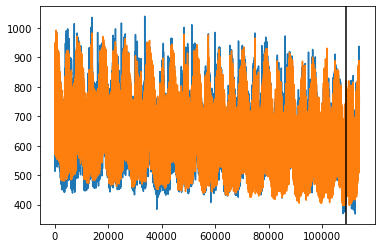

k = 4


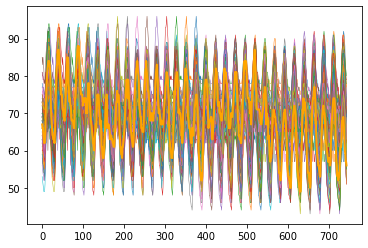

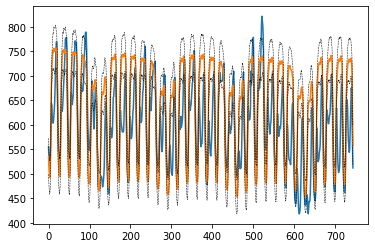

{'VT': 25.560840058298247}
2006-07-11 00:00:00
VT


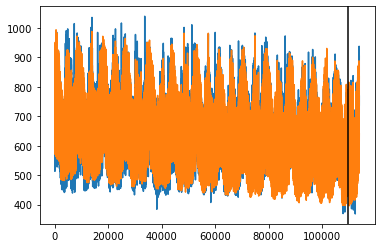

k = 4


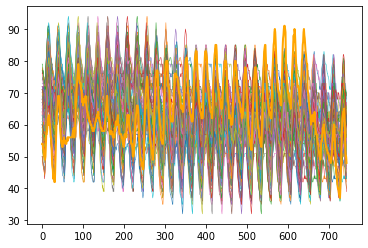

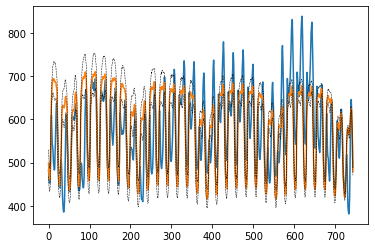

{'VT': 25.55991251884145}
2006-08-10 00:00:00
VT


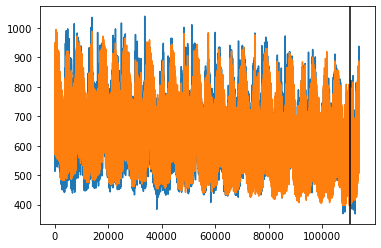

k = 4


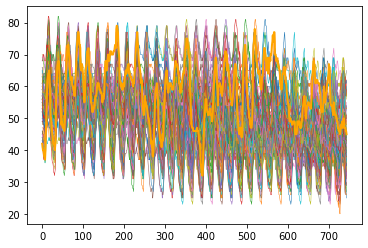

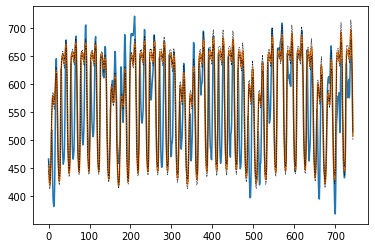

{'VT': 20.040321972003404}
2006-09-10 00:00:00
VT


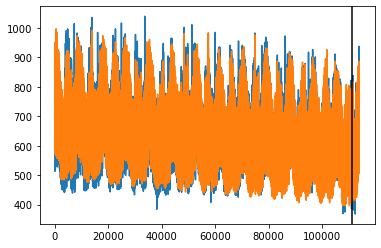

k = 4


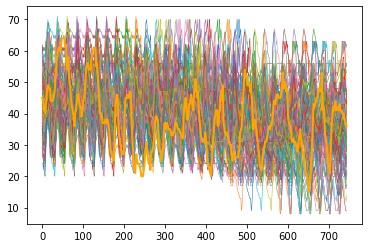

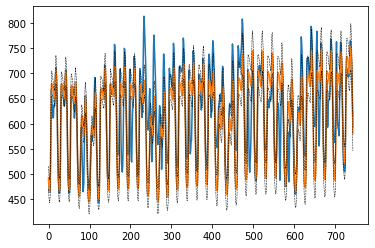

{'VT': 16.8536080672572}
2006-10-10 00:00:00
VT


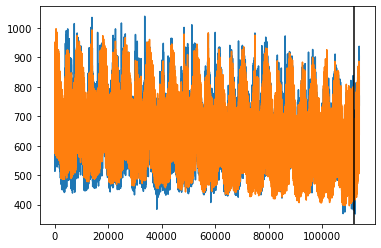

k = 4


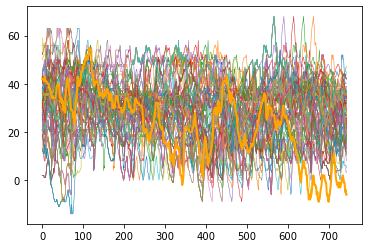

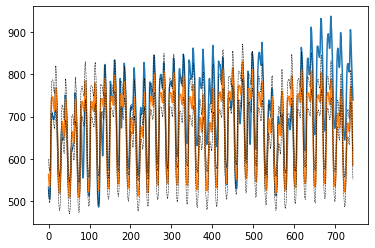

{'VT': 22.35610761956649}
CT
2005-11-10 00:00:00
CT


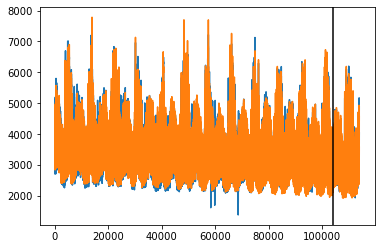

k = 4


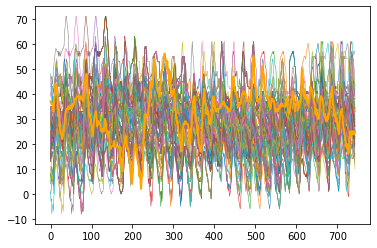

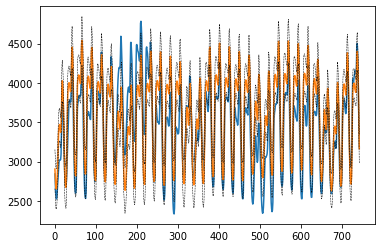

{'CT': 109.64124058305158}
2005-12-11 00:00:00
CT


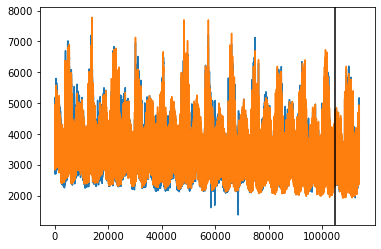

k = 4


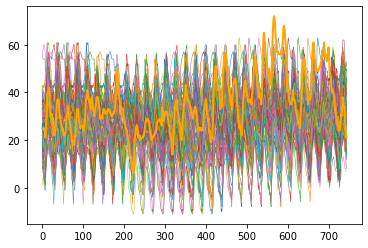

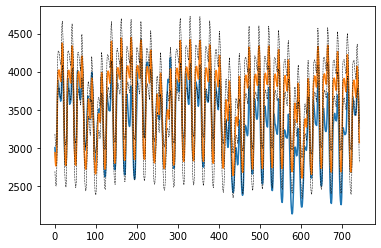

{'CT': 113.07040798789514}
2006-01-08 00:00:00
CT


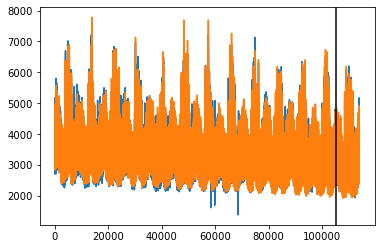

k = 4


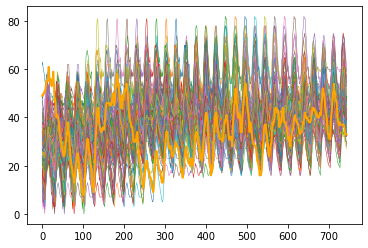

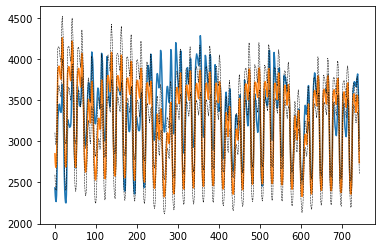

{'CT': 107.38870119070785}
2006-02-08 00:00:00
CT


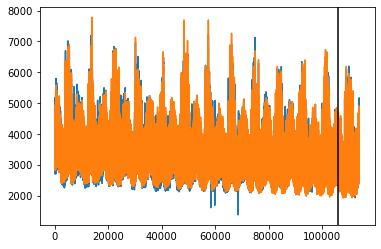

k = 4


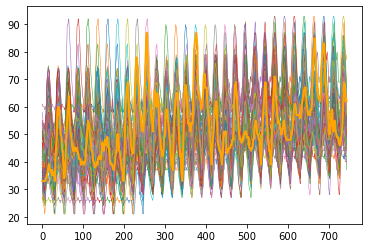

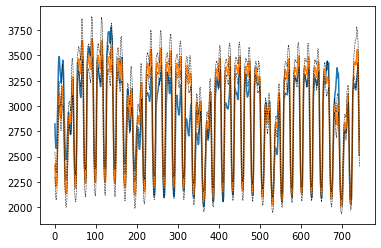

{'CT': 55.777437825515435}
2006-03-10 00:00:00
CT


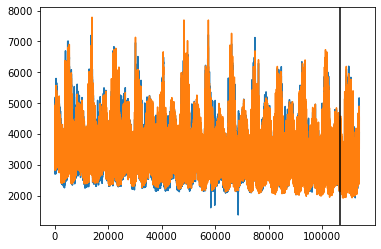

k = 4


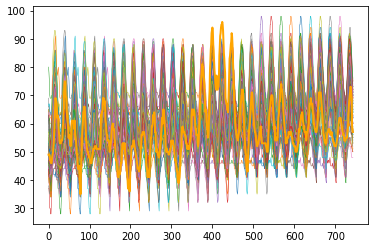

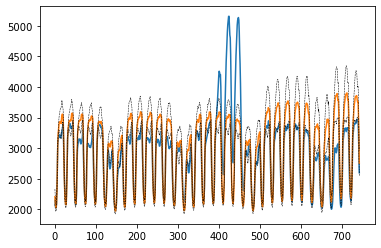

{'CT': 101.03837552526281}
2006-04-10 00:00:00
CT


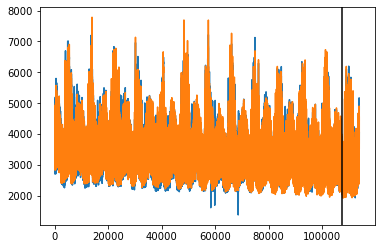

k = 4


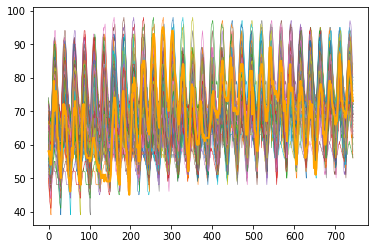

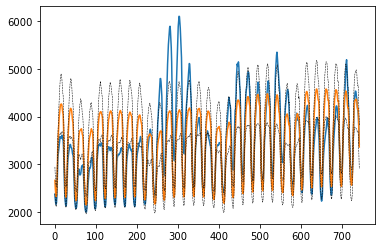

{'CT': 162.00682483760525}
2006-05-10 00:00:00
CT


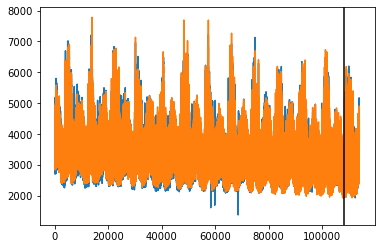

k = 4


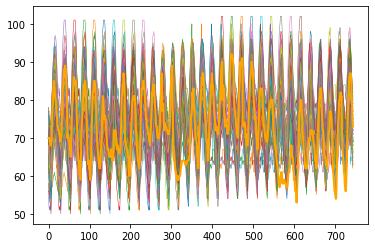

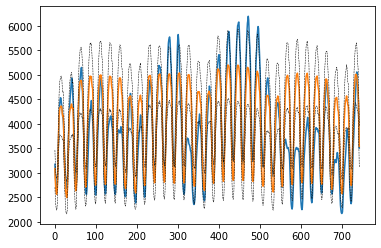

{'CT': 173.35265777211984}
2006-06-10 00:00:00
CT


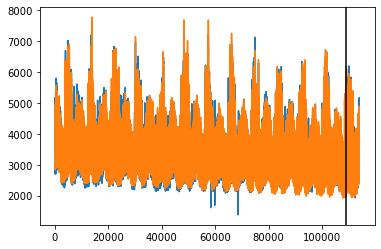

k = 4


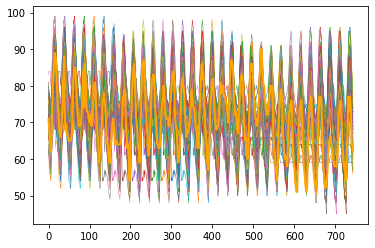

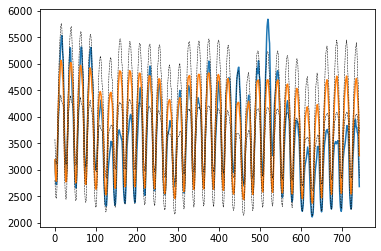

{'CT': 140.072119223232}
2006-07-11 00:00:00
CT


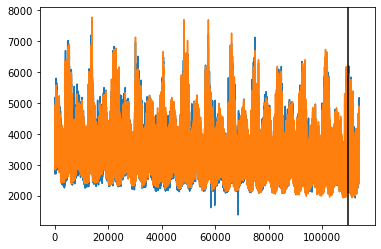

k = 4


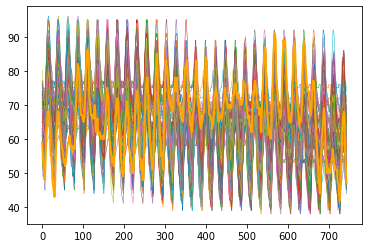

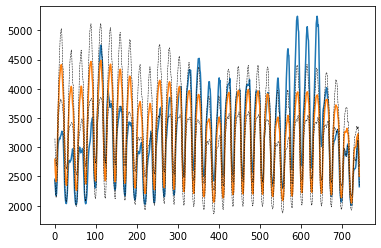

{'CT': 160.19797391920127}
2006-08-10 00:00:00
CT


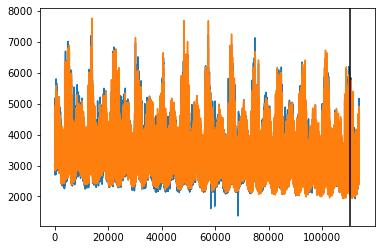

k = 4


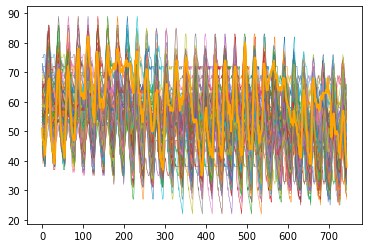

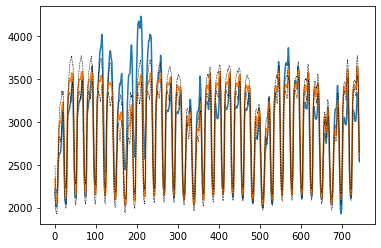

{'CT': 78.18906383206543}
2006-09-10 00:00:00
CT


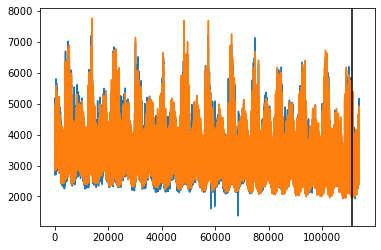

k = 4


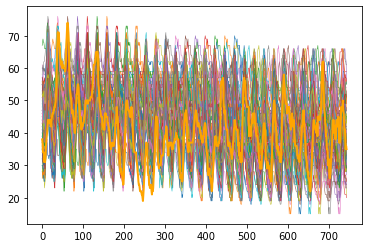

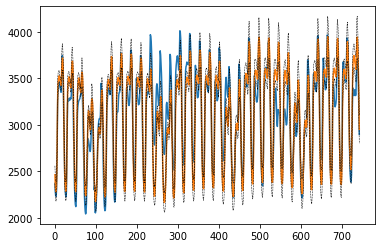

{'CT': 68.55768780106516}
2006-10-10 00:00:00
CT


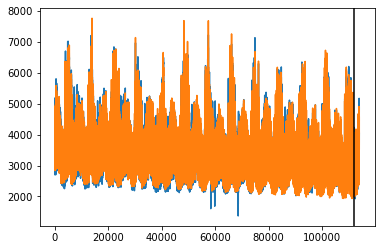

k = 4


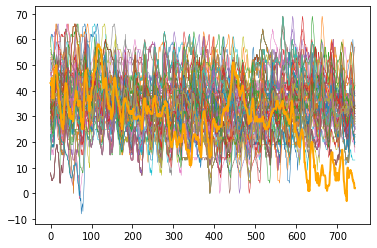

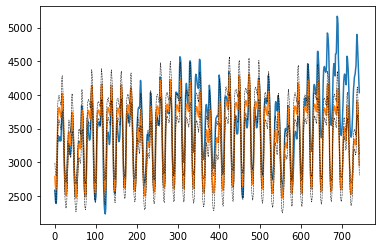

{'CT': 120.56417273928882}
NH
2005-11-10 00:00:00
NH


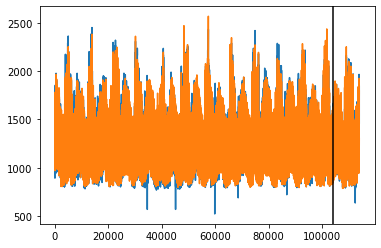

k = 4


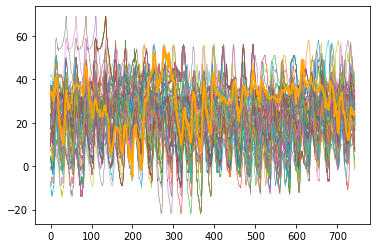

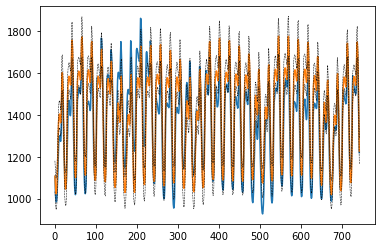

{'NH': 33.9566984279856}
2005-12-11 00:00:00
NH


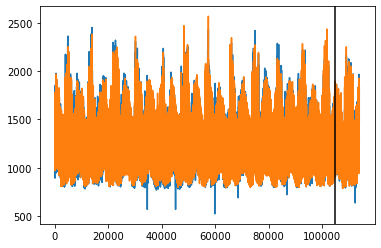

k = 4


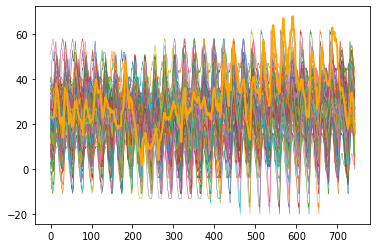

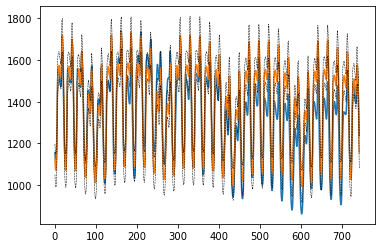

{'NH': 31.818734198224107}
2006-01-08 00:00:00
NH


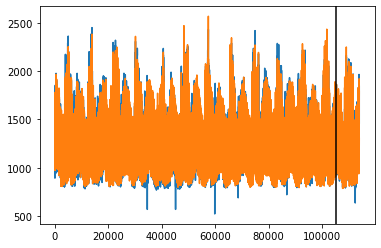

k = 4


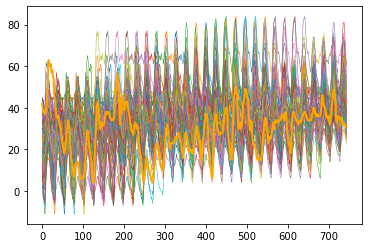

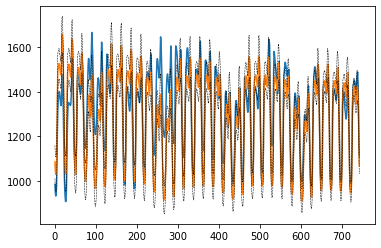

{'NH': 32.15972951509543}
2006-02-08 00:00:00
NH


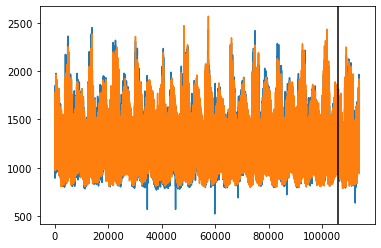

k = 4


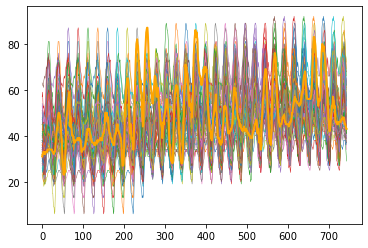

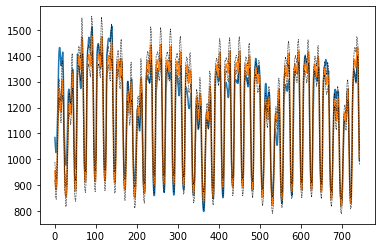

{'NH': 17.236332582516514}
2006-03-10 00:00:00
NH


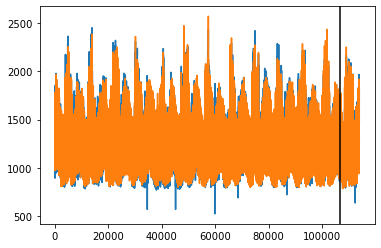

k = 4


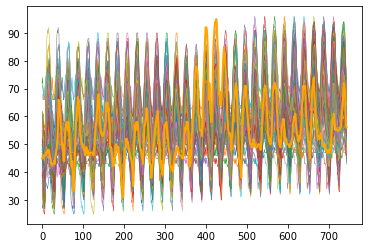

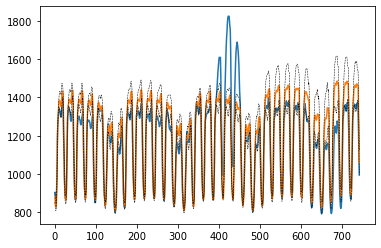

{'NH': 27.814300177731646}
2006-04-10 00:00:00
NH


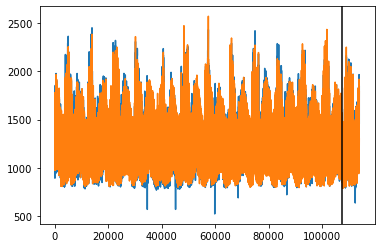

k = 4


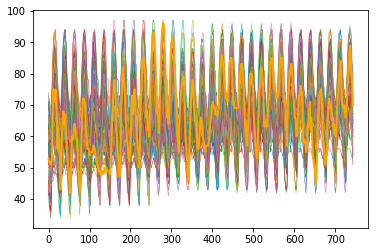

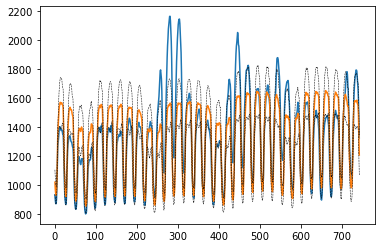

{'NH': 50.64747492756817}
2006-05-10 00:00:00
NH


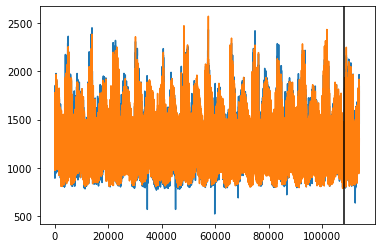

k = 4


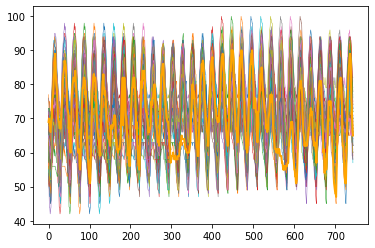

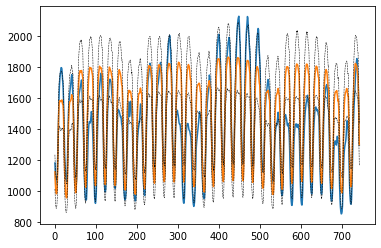

{'NH': 51.39273428015884}
2006-06-10 00:00:00
NH


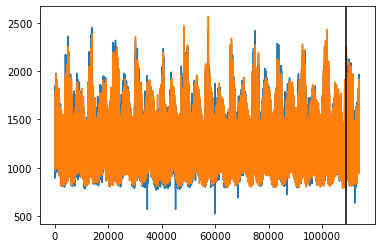

k = 4


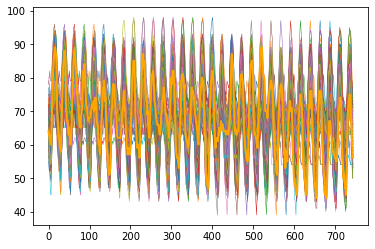

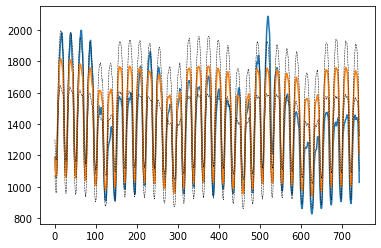

{'NH': 41.86378787088924}
2006-07-11 00:00:00
NH


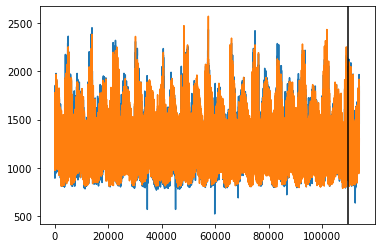

k = 4


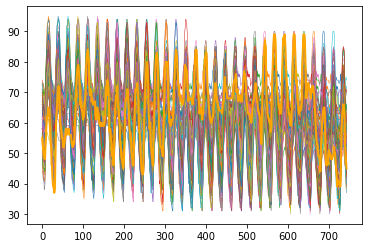

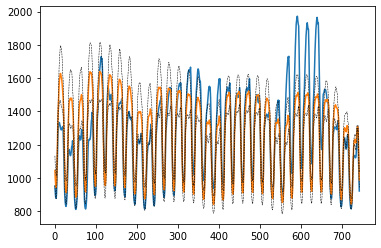

{'NH': 47.05641423270474}
2006-08-10 00:00:00
NH


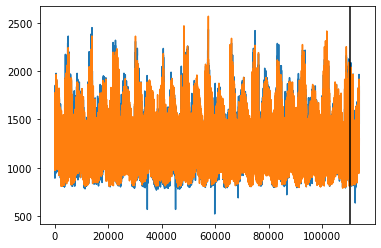

k = 4


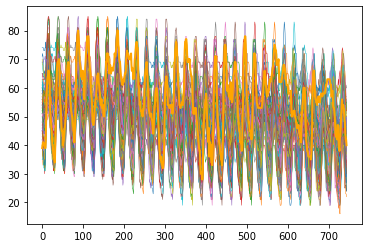

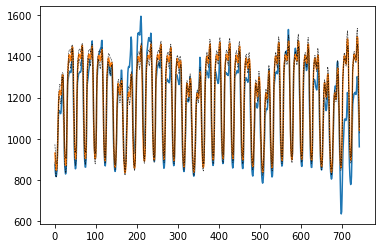

{'NH': 26.877181409554677}
2006-09-10 00:00:00
NH


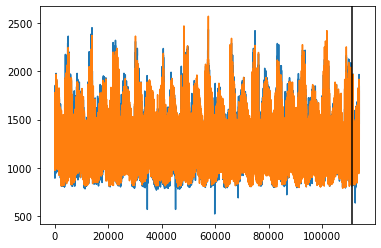

k = 4


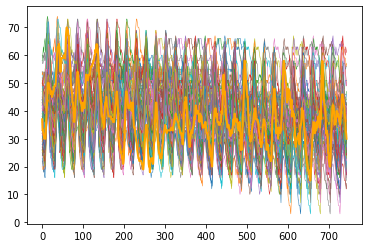

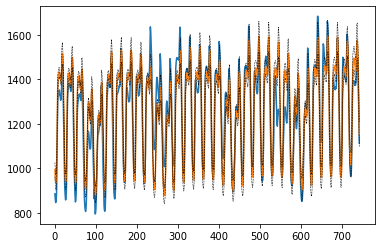

{'NH': 27.0372036748085}
2006-10-10 00:00:00
NH


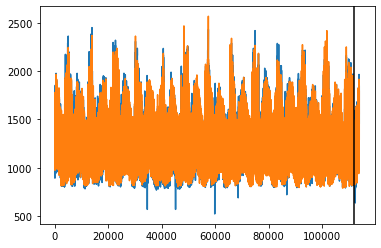

k = 4


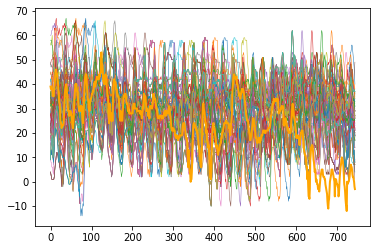

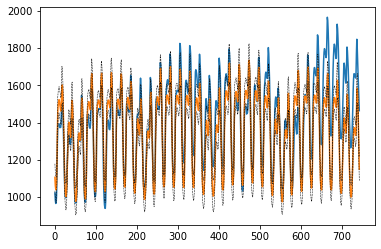

{'NH': 39.806307014459755}
SEMASS
2005-11-10 00:00:00
SEMASS


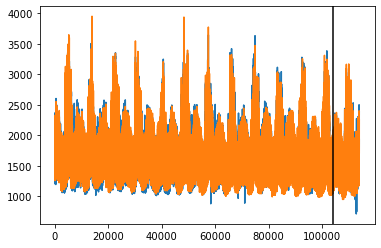

k = 4


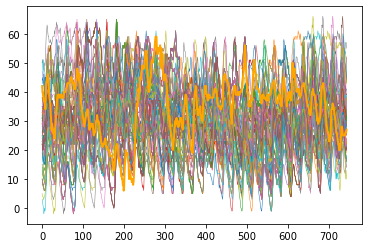

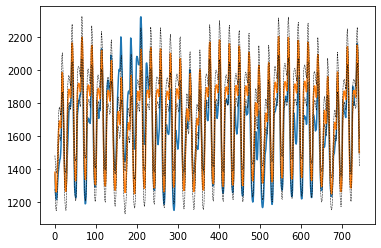

{'SEMASS': 48.90390935768163}
2005-12-11 00:00:00
SEMASS


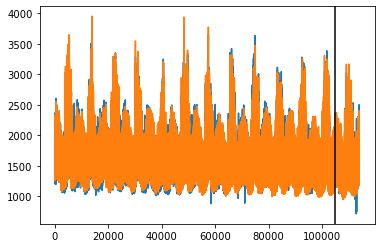

k = 4


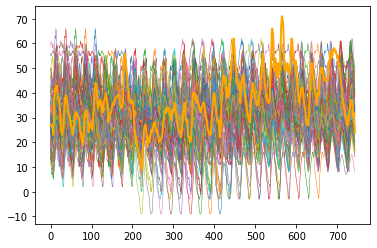

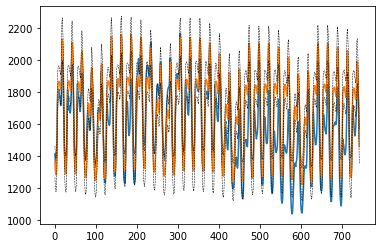

{'SEMASS': 56.54383712644797}
2006-01-08 00:00:00
SEMASS


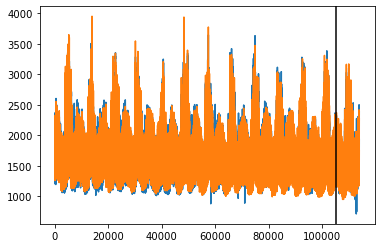

k = 4


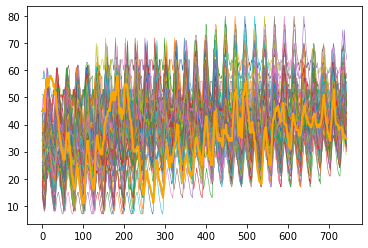

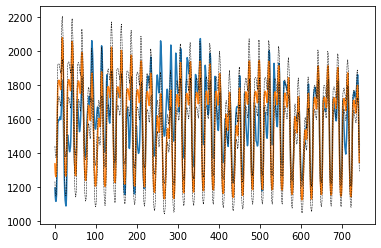

{'SEMASS': 50.15547131810702}
2006-02-08 00:00:00
SEMASS


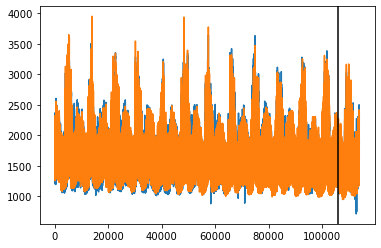

k = 4


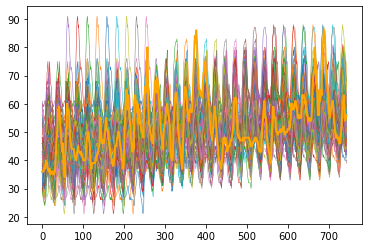

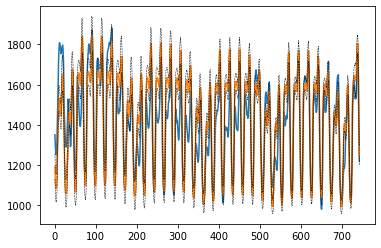

{'SEMASS': 36.40889653873159}
2006-03-10 00:00:00
SEMASS


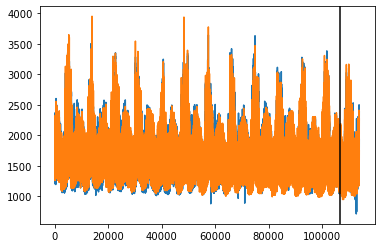

k = 4


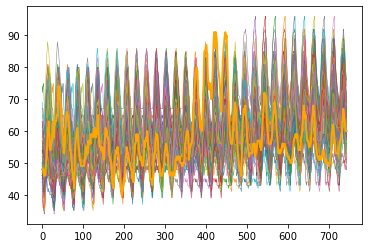

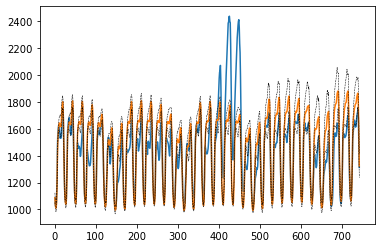

{'SEMASS': 48.89969977379653}
2006-04-10 00:00:00
SEMASS


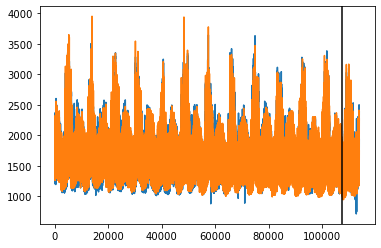

k = 4


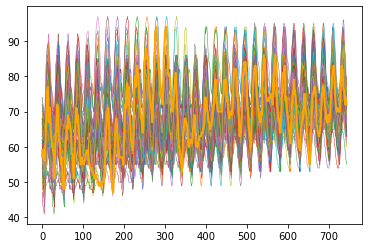

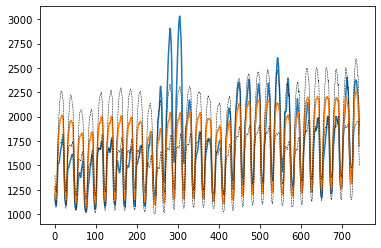

{'SEMASS': 72.7853711593881}
2006-05-10 00:00:00
SEMASS


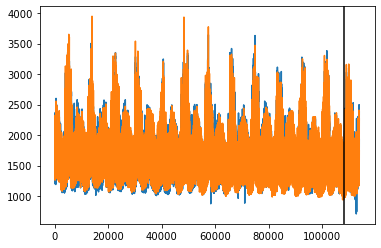

k = 4


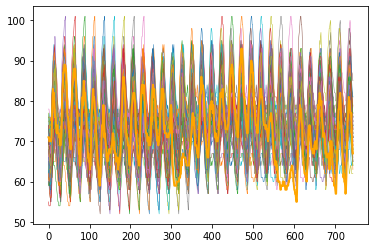

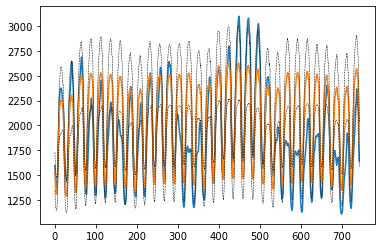

{'SEMASS': 100.11782307875013}
2006-06-10 00:00:00
SEMASS


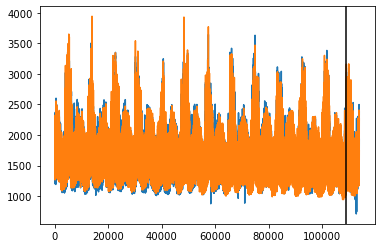

k = 4


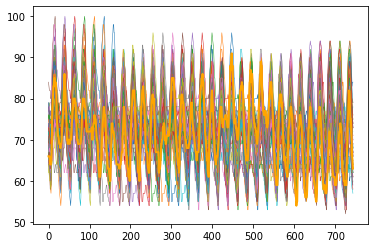

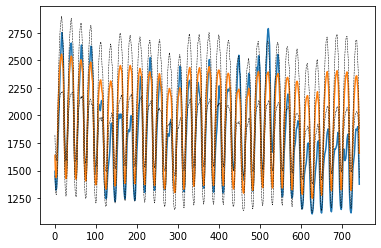

{'SEMASS': 75.12822738768183}
2006-07-11 00:00:00
SEMASS


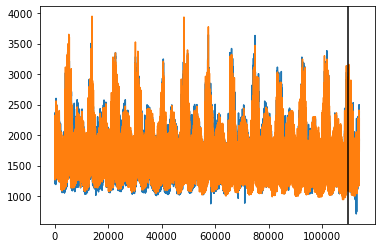

k = 4


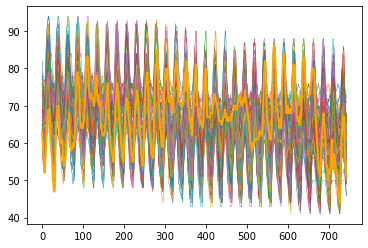

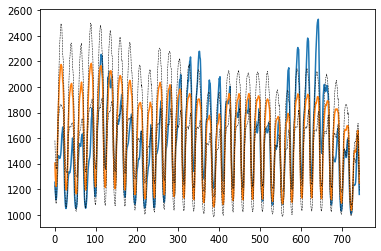

{'SEMASS': 68.04345188830617}
2006-08-10 00:00:00
SEMASS


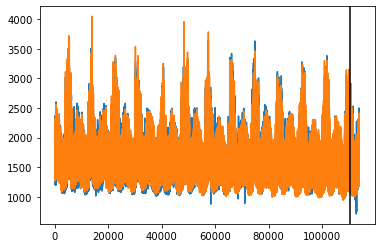

k = 4


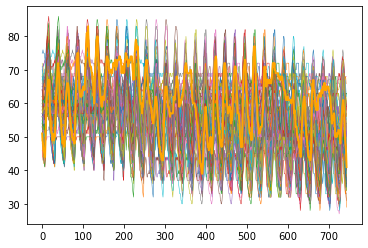

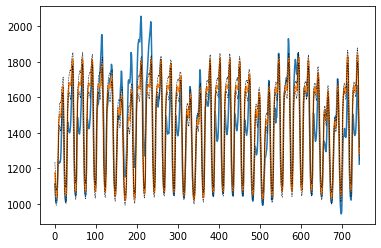

{'SEMASS': 42.58982433989457}
2006-09-10 00:00:00
SEMASS


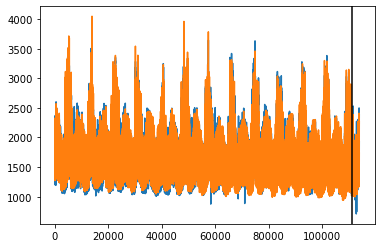

k = 4


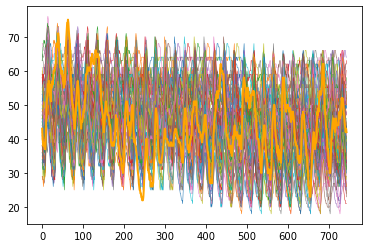

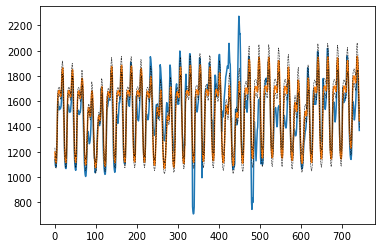

{'SEMASS': 48.946806193926605}
2006-10-10 00:00:00
SEMASS


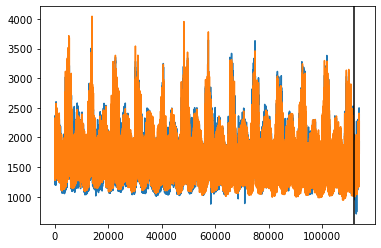

k = 4


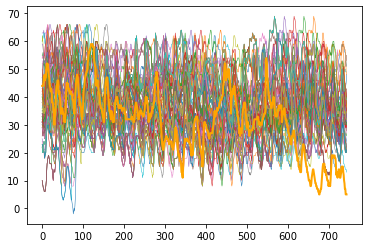

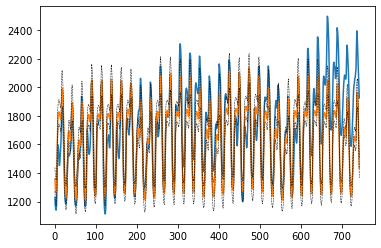

{'SEMASS': 57.67216403555557}
WCMASS
2005-11-10 00:00:00
WCMASS


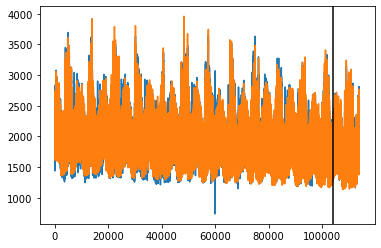

k = 4


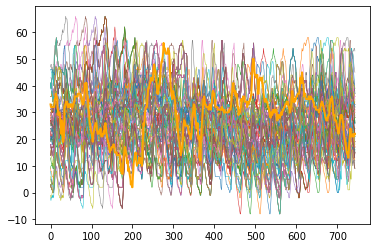

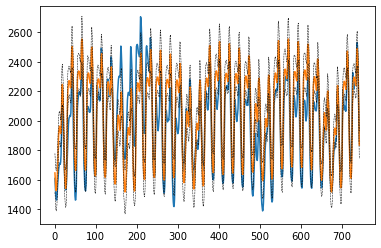

{'WCMASS': 53.23794920206294}
2005-12-11 00:00:00
WCMASS


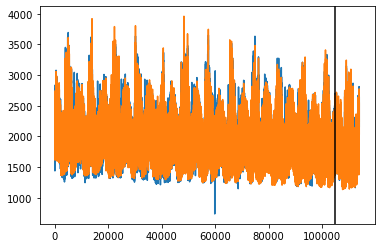

k = 4


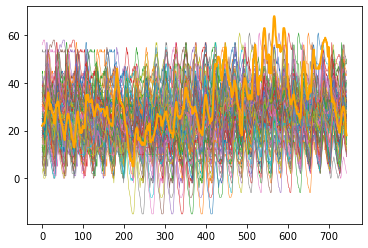

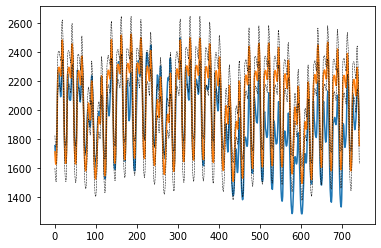

{'WCMASS': 64.65842258079017}
2006-01-08 00:00:00
WCMASS


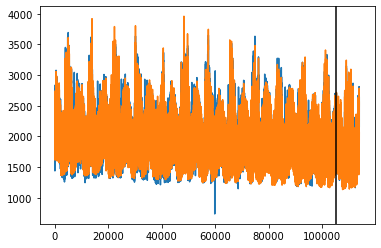

k = 4


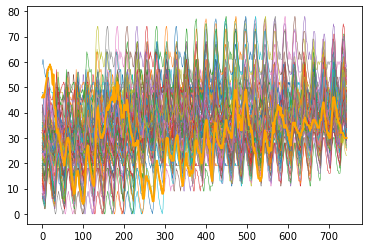

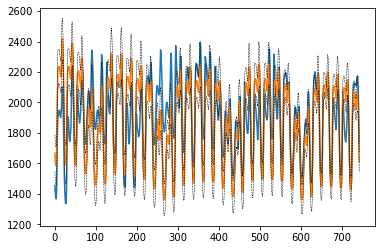

{'WCMASS': 56.82426273355672}
2006-02-08 00:00:00
WCMASS


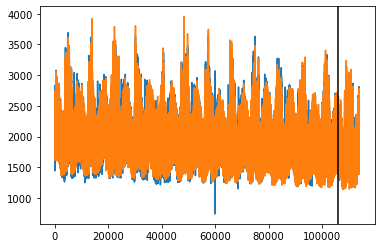

k = 4


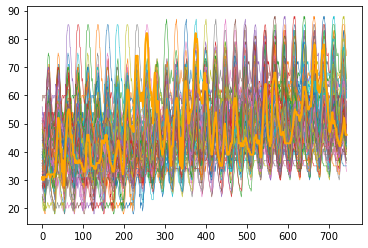

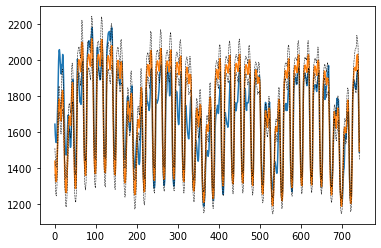

{'WCMASS': 36.61426014612751}
2006-03-10 00:00:00
WCMASS


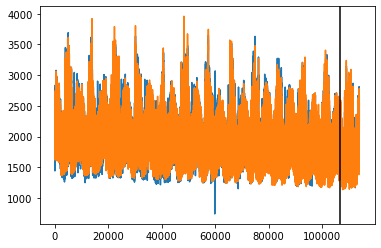

k = 4


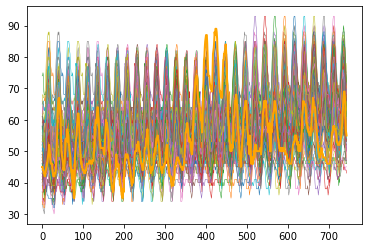

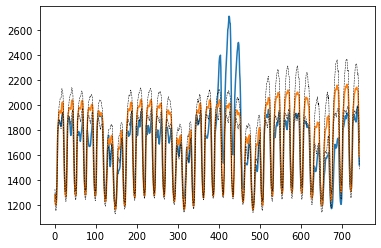

{'WCMASS': 52.405287384306725}
2006-04-10 00:00:00
WCMASS


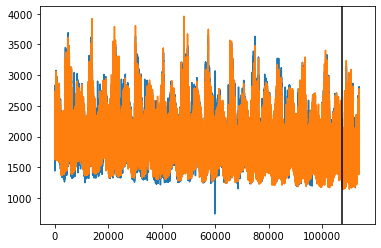

k = 4


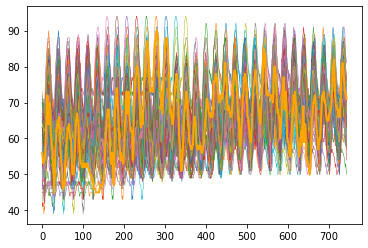

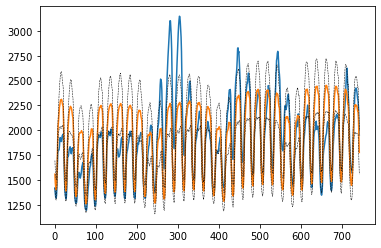

{'WCMASS': 81.1840835772649}
2006-05-10 00:00:00
WCMASS


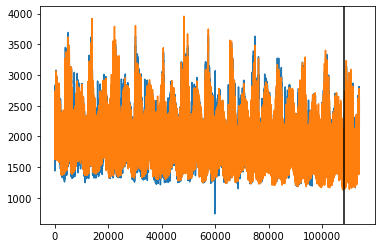

k = 4


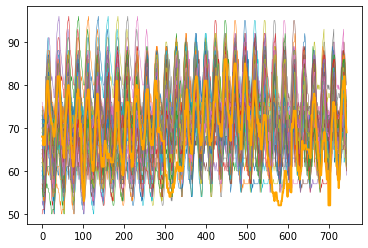

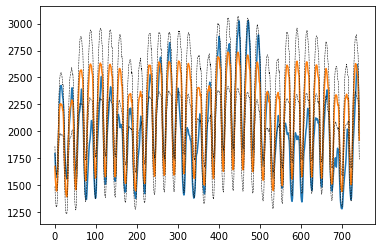

{'WCMASS': 85.92830148410067}
2006-06-10 00:00:00
WCMASS


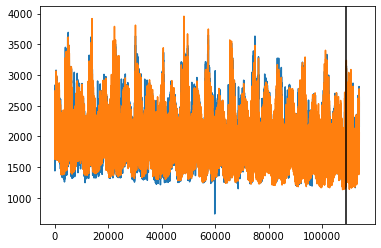

k = 4


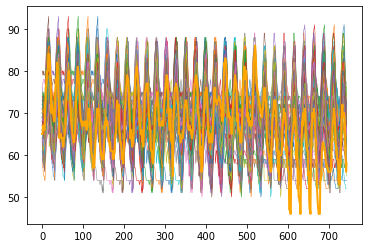

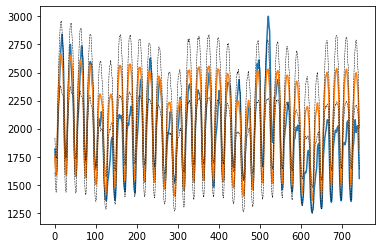

{'WCMASS': 69.6434522479204}
2006-07-11 00:00:00
WCMASS


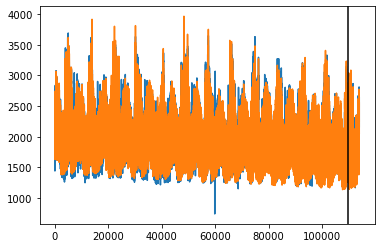

k = 4


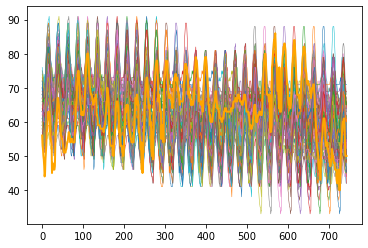

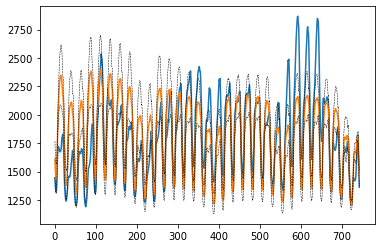

{'WCMASS': 80.61643713232905}
2006-08-10 00:00:00
WCMASS


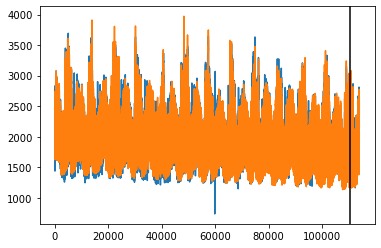

k = 4


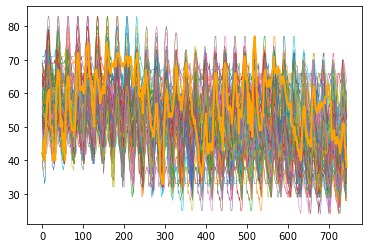

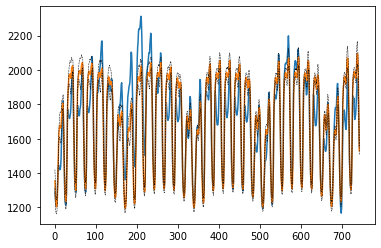

{'WCMASS': 38.368808201219515}
2006-09-10 00:00:00
WCMASS


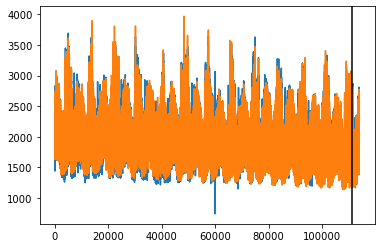

k = 4


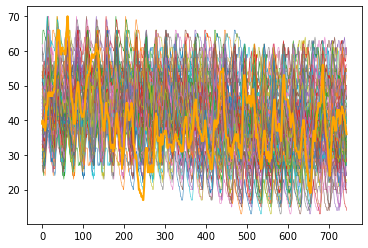

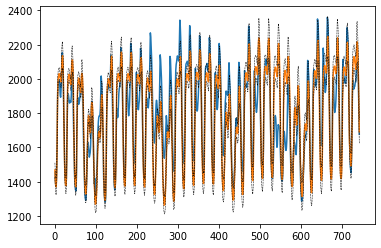

{'WCMASS': 42.55658871427208}
2006-10-10 00:00:00
WCMASS


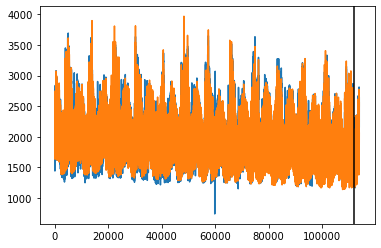

k = 4


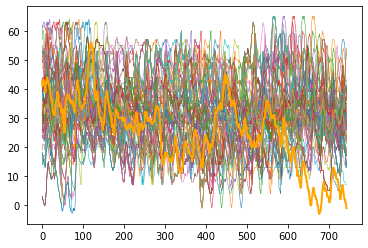

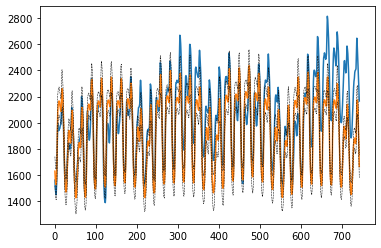

{'WCMASS': 67.69004686901725}
NEMASSBOST
2005-11-10 00:00:00
NEMASSBOST


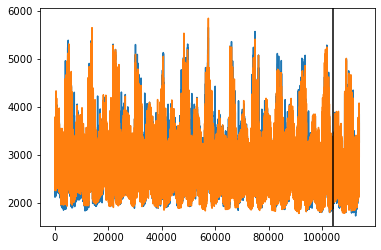

k = 4


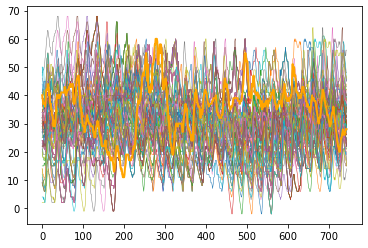

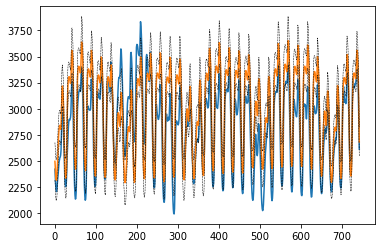

{'NEMASSBOST': 86.69236536323379}
2005-12-11 00:00:00
NEMASSBOST


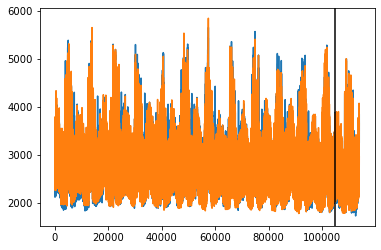

k = 4


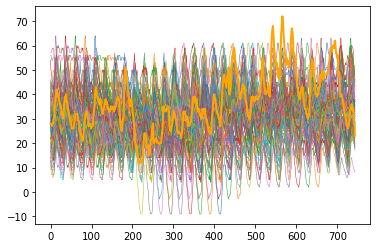

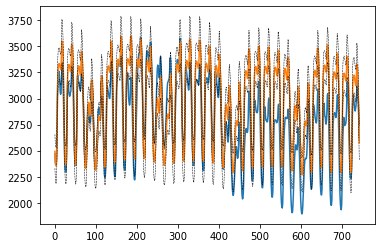

{'NEMASSBOST': 90.66554047152805}
2006-01-08 00:00:00
NEMASSBOST


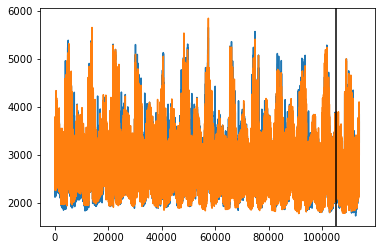

k = 4


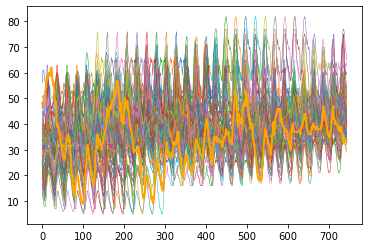

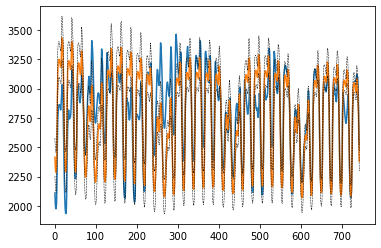

{'NEMASSBOST': 73.38166974932938}
2006-02-08 00:00:00
NEMASSBOST


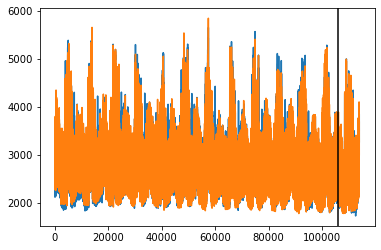

k = 4


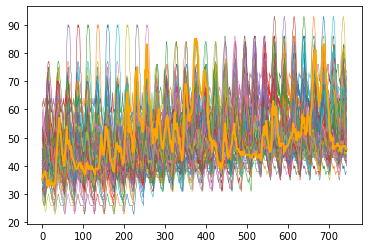

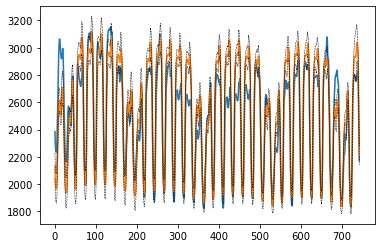

{'NEMASSBOST': 47.5049015396934}
2006-03-10 00:00:00
NEMASSBOST


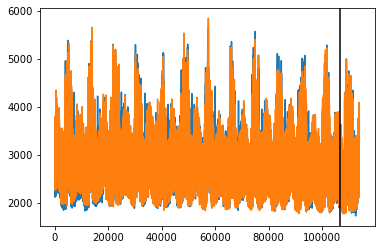

k = 4


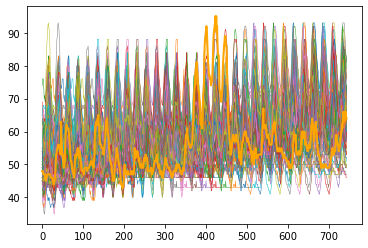

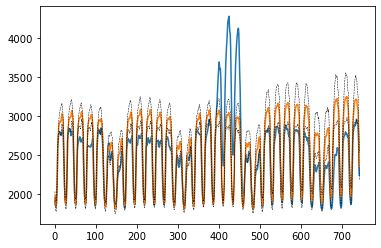

{'NEMASSBOST': 86.78835895773342}
2006-04-10 00:00:00
NEMASSBOST


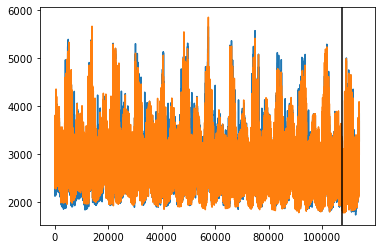

k = 4


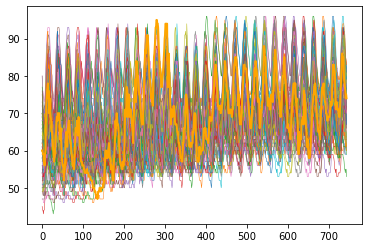

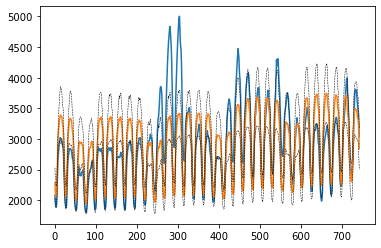

{'NEMASSBOST': 129.85896663226688}
2006-05-10 00:00:00
NEMASSBOST


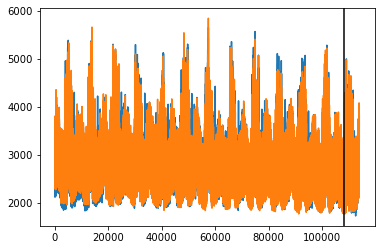

k = 4


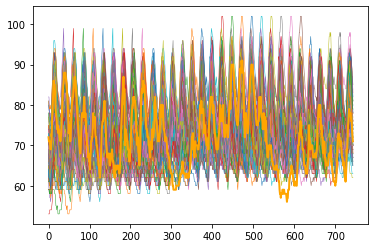

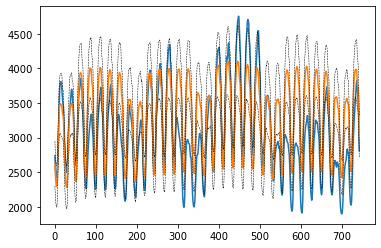

{'NEMASSBOST': 151.5238984858736}
2006-06-10 00:00:00
NEMASSBOST


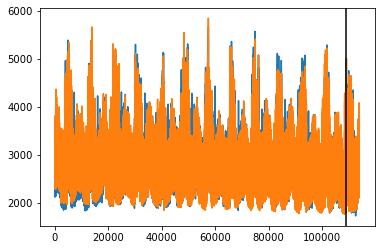

k = 4


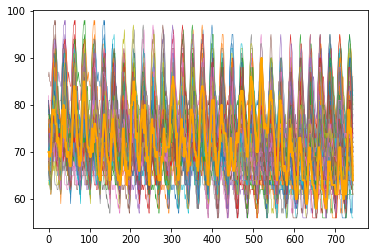

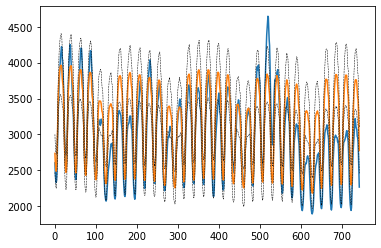

{'NEMASSBOST': 106.00765062100191}
2006-07-11 00:00:00
NEMASSBOST


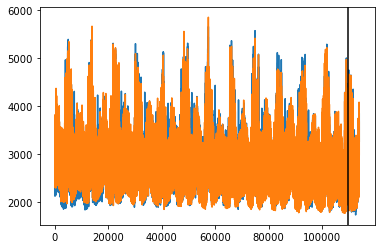

k = 4


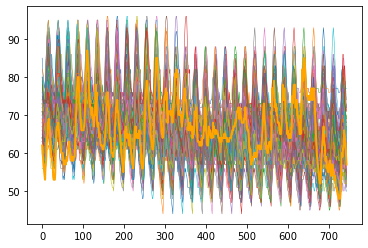

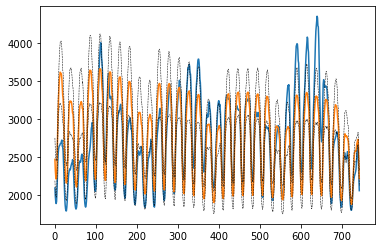

{'NEMASSBOST': 115.06574765310403}
2006-08-10 00:00:00
NEMASSBOST


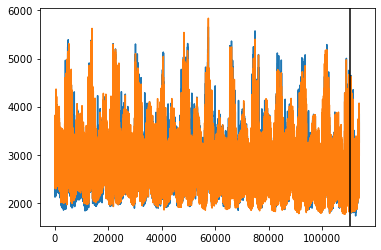

k = 4


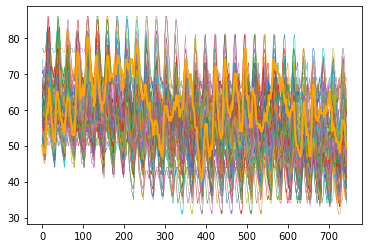

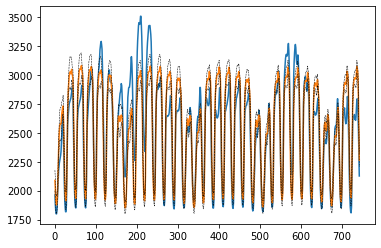

{'NEMASSBOST': 62.2036994548293}
2006-09-10 00:00:00
NEMASSBOST


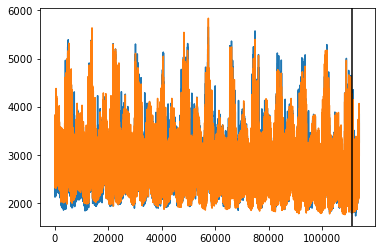

k = 4


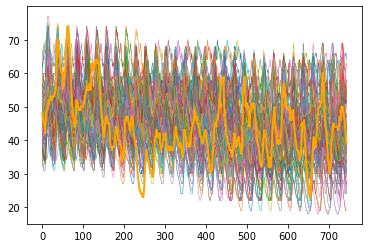

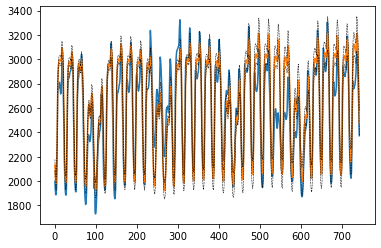

{'NEMASSBOST': 55.525087584704806}
2006-10-10 00:00:00
NEMASSBOST


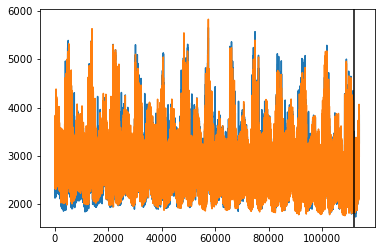

k = 4


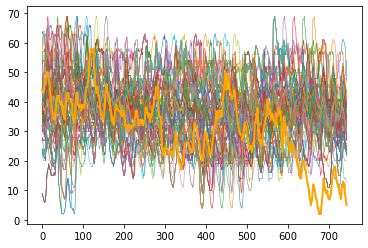

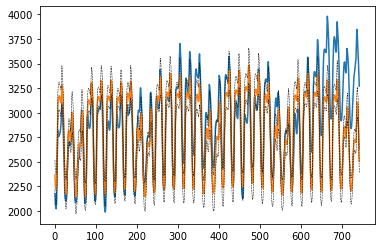

{'NEMASSBOST': 87.71579116908799}
{'ISONE CA': [396.80724510688697, 409.13201995070347, 373.5736890307723, 216.56437790241225, 358.0472823830687, 560.1433664017665, 637.5725866361081, 492.79067317304356, 546.8176847562634, 297.1252275578539, 275.4528671832223, 444.53341320939836], 'ME': [28.415283347371133, 24.285066419107142, 25.37834533302525, 18.13171850954474, 17.12675354981821, 27.557409519537448, 32.32882313921198, 25.501681740200993, 25.138356572177823, 30.640453870158066, 28.221124439927713, 37.533138489271415], 'RI': [23.931533993033284, 25.973438764561777, 22.776366882964062, 12.621410383342402, 22.181188292396556, 40.184768197183345, 49.48678211986186, 36.72894705010676, 39.95675449533233, 21.063445636986287, 14.912208747014711, 24.64585923060675], 'VT': [22.959252952672337, 16.490437964962375, 22.68469889021351, 18.741538290194963, 19.900982951282597, 22.81754514086226, 26.19064367998076, 25.560840058298247, 25.55991251884145, 20.040321972003404, 16.8536080672572, 22.356107

In [10]:
# vanilla_losses = [397.54593426786477, 604.6018135096928, 329.1556644285198, 197.8631423987858, 323.53210964925717, 415.8909833353536, 544.7284618154562, 540.057213205938, 570.237691916539, 181.8698616921875, 262.12280478463936, 471.97246124553413]
# vanilla_losses = {'ISONE CA': [396.80724510688697, 409.13201995070347, 373.5736890307723, 216.56437790241225, 358.0472823830687, 560.1433664017665, 637.5725866361081, 492.79067317304356, 546.8176847562634, 297.1252275578539, 275.4528671832223, 444.53341320939836], 'ME': [28.415283347371133, 24.285066419107142, 25.37834533302525, 18.13171850954474, 17.12675354981821, 27.557409519537448, 32.32882313921198, 25.501681740200993, 25.138356572177823, 30.640453870158066, 28.221124439927713, 37.533138489271415], 'RI': [23.931533993033284, 25.973438764561777, 22.776366882964062, 12.621410383342402, 22.181188292396556, 40.184768197183345, 49.48678211986186, 36.72894705010676, 39.95675449533233, 21.063445636986287, 14.912208747014711, 24.64585923060675], 'VT': [22.959252952672337, 16.490437964962375, 22.68469889021351, 18.741538290194963, 19.900982951282597, 22.81754514086226, 26.19064367998076, 25.560840058298247, 25.55991251884145, 20.040321972003404, 16.8536080672572, 22.35610761956649], 'CT': [109.64124058305158, 113.07040798789514, 107.38870119070785, 55.777437825515435, 101.03837552526281, 162.00682483760525, 173.35265777211984, 140.072119223232, 160.19797391920127, 78.18906383206543, 68.55768780106516, 120.56417273928882], 'NH': [33.9566984279856, 31.818734198224107, 32.15972951509543, 17.236332582516514, 27.814300177731646, 50.64747492756817, 51.39273428015884, 41.86378787088924, 47.05641423270474, 26.877181409554677, 27.0372036748085, 39.806307014459755], 'SEMASS': [48.90390935768163, 56.54383712644797, 50.15547131810702, 36.40889653873159, 48.89969977379653, 72.7853711593881, 100.11782307875013, 75.12822738768183, 68.04345188830617, 42.58982433989457, 48.946806193926605, 57.67216403555557], 'WCMASS': [53.23794920206294, 64.65842258079017, 56.82426273355672, 36.61426014612751, 52.405287384306725, 81.1840835772649, 85.92830148410067, 69.6434522479204, 80.61643713232905, 38.368808201219515, 42.55658871427208, 67.69004686901725], 'NEMASSBOST': [86.69236536323379, 90.66554047152805, 73.38166974932938, 47.5049015396934, 86.78835895773342, 129.85896663226688, 151.5238984858736, 106.00765062100191, 115.06574765310403, 62.2036994548293, 55.525087584704806, 87.71579116908799]}
vanilla_losses = dict()
for zone_name in all_data.keys():
    print(zone_name)
    vanilla_losses[zone_name] = []
    for start_date in train_start_dates:
        print(start_date)
        loss = vanilla_benchmark.get_lossesGEFCom(11, 31 * 24, start_date=start_date, zones=[zone_name],
                              delay_days=delay_delta.days, temp_years=np.arange(2006, 2017), plot=True)[zone_name]
        vanilla_losses[zone_name].append(loss)
print(vanilla_losses)

# Forecasting mean, variance, and skewness of Skew-Normal distribution

In [12]:
# rescale data
x_original = data
mean = np.mean(data, axis=0)
rnge = np.max(data, axis=0) - np.min(data, axis=0)
data = (data - np.matlib.repmat(mean, data.shape[0], 1)) / np.matlib.repmat(rnge, data.shape[0], 1)
print("data", data.shape)

data (96408, 1)


In [13]:
%matplotlib inline
z_scores = []
test_z_scores = []
losses = []
relative_perfs = []

TRAIN START: 78888 = 2014-01-01 00:00:00
x (9504, 1)
xt (8760, 1)
Loss at iteration 10: 1.704802057558942
Loss at iteration 60: -1.399573030684537
Loss at iteration 110: -1.881065680700619
Loss at iteration 160: -1.9851699930451518
Loss at iteration 210: -2.033537932780065
Loss at iteration 260: -2.065658637333161
Loss at iteration 310: -2.1000257712541743
Loss at iteration 360: -2.1273378756934034
Loss at iteration 410: -2.151374609331084
Loss at iteration 460: -2.1811538141543805
Loss at iteration 510: -2.1955306905342553
Loss at iteration 560: -2.2160874727928146
Final loss: -2.237155593991467


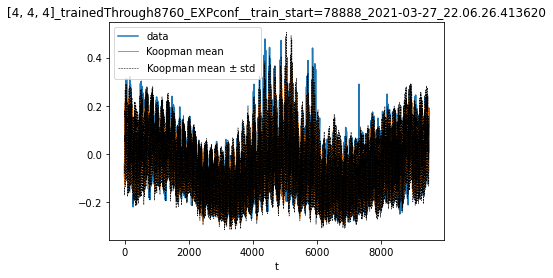

actual overall mean: 0  predicted mean: -0.017357843


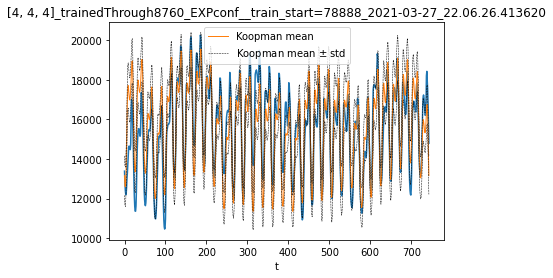

pinball_loss: 334.5064221903896
15.857164328336303% performance relative to vanilla benchmark





TRAIN START: 80344 = 2014-03-02 00:00:00
x (9504, 1)
xt (8760, 1)
Loss at iteration 10: 1.5797249723129227
Loss at iteration 60: -1.4680139513175368
Loss at iteration 110: -1.9731072320433634
Loss at iteration 160: -2.0582170136294864
Loss at iteration 210: -2.107847896123022
Loss at iteration 260: -2.1452499234469826
Loss at iteration 310: -2.1761667604466113
Loss at iteration 360: -2.2102595112969157
Loss at iteration 410: -2.2375568704390494
Loss at iteration 460: -2.278539847719959
Loss at iteration 510: -2.3105361621114278
Loss at iteration 560: -2.337538453655036
Final loss: -2.3513435855883396


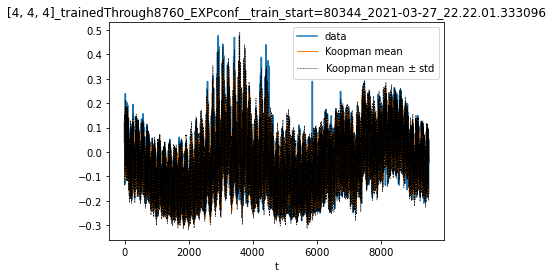

actual overall mean: 0  predicted mean: -0.015072249


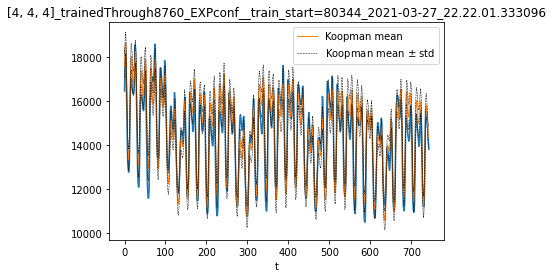

pinball_loss: 203.73494640644685
38.103770214566545% performance relative to vanilla benchmark





TRAIN START: 81800 = 2014-05-02 00:00:00
x (9504, 1)
xt (8760, 1)
Loss at iteration 10: 1.9756109955652466
Loss at iteration 60: -1.3300598388985523
Loss at iteration 110: -1.9228038116167807
Loss at iteration 160: -2.0294797913308966
Loss at iteration 210: -2.0945234319941823
Loss at iteration 260: -2.131238527913021
Loss at iteration 310: -2.1671897103402795
Loss at iteration 360: -2.202742801756144
Loss at iteration 410: -2.2364313450834636
Loss at iteration 460: -2.2583613255837913
Loss at iteration 510: -2.288854827464717
Loss at iteration 560: -2.31891494309698
Final loss: -2.3411386605072106


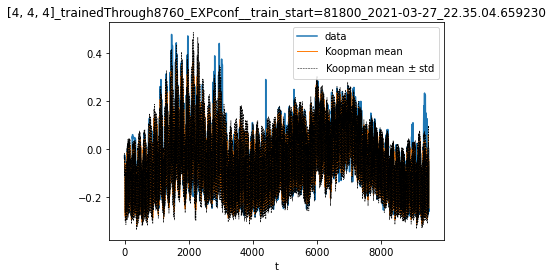

actual overall mean: 0  predicted mean: -0.01744134


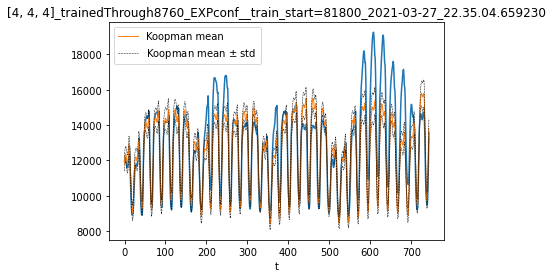

pinball_loss: 364.0798459836028
-12.532832174928066% performance relative to vanilla benchmark





TRAIN START: 83256 = 2014-07-02 00:00:00
x (9504, 1)
xt (8760, 1)
Loss at iteration 10: 1.8015218799675263
Loss at iteration 60: -1.383012195815831
Loss at iteration 110: -1.8589221429616771
Loss at iteration 160: -1.968053349192122
Loss at iteration 210: -2.0143485676363215
Loss at iteration 260: -2.043394475149231
Loss at iteration 310: -2.0671410819638454
Loss at iteration 360: -2.0938053097260347
Loss at iteration 410: -2.1111098926136975
Loss at iteration 460: -2.1341914870795837
Loss at iteration 510: -2.154776065334802
Loss at iteration 560: -2.1747333905749175
Final loss: -2.2004284904412086


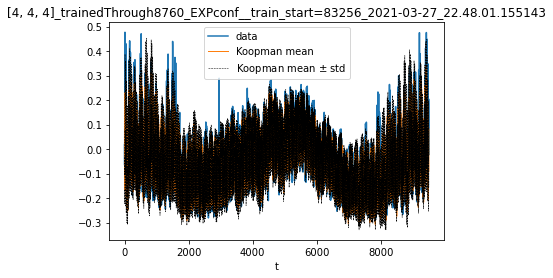

actual overall mean: 0  predicted mean: -0.018299568


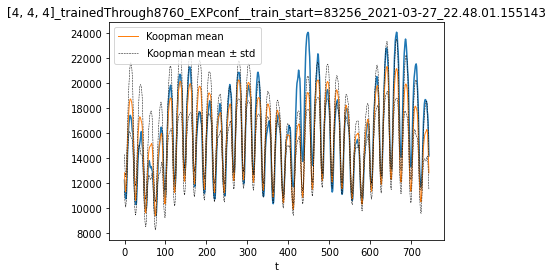

pinball_loss: 428.4206071985964
21.351528838649656% performance relative to vanilla benchmark





TRAIN START: 84712 = 2014-08-31 00:00:00
x (9504, 1)
xt (8760, 1)
Loss at iteration 10: 1.6361040958122677
Loss at iteration 60: -1.273746134416223
Loss at iteration 110: -1.751955064614918
Loss at iteration 160: -1.864898828644886
Loss at iteration 210: -1.9333196289879233
Loss at iteration 260: -1.99994485868363
Loss at iteration 310: -2.0422576417179976
Loss at iteration 360: -2.070099522532096
Loss at iteration 410: -2.0912297398087385
Loss at iteration 460: -2.1153946237100816
Loss at iteration 510: -2.1329102962831765
Loss at iteration 560: -2.153267039513244
Final loss: -2.162561770674592


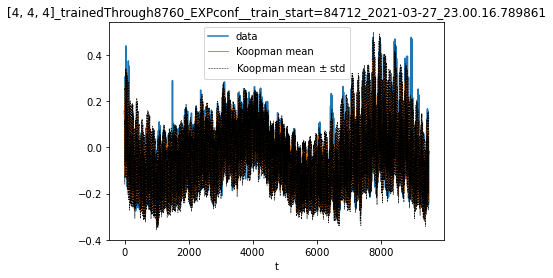

actual overall mean: 0  predicted mean: -0.011335393


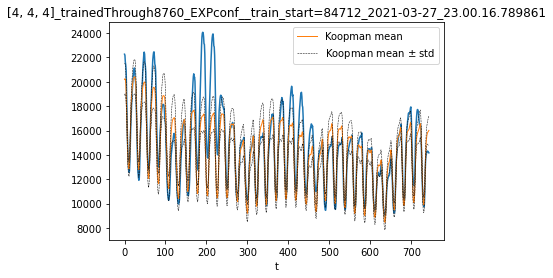

pinball_loss: 456.0589137490183
20.0230149262445% performance relative to vanilla benchmark





TRAIN START: 86168 = 2014-10-31 00:00:00
x (9504, 1)
xt (8760, 1)
Loss at iteration 10: 1.4544686022951636
Loss at iteration 60: -1.3695115687730328
Loss at iteration 110: -1.8303060024946403
Loss at iteration 160: -1.90079905058755
Loss at iteration 210: -1.9645355394689894
Loss at iteration 260: -2.0146625631203148
Loss at iteration 310: -2.0448275700833225
Loss at iteration 360: -2.073790120988476
Loss at iteration 410: -2.1078330040222237
Loss at iteration 460: -2.1342230549820163
Loss at iteration 510: -2.1670180948798365
Loss at iteration 560: -2.195661211358331
Final loss: -2.2284170989436287


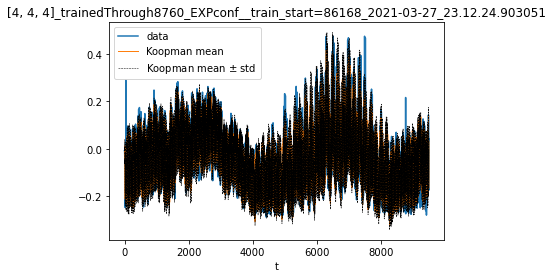

actual overall mean: 0  predicted mean: -0.009782841


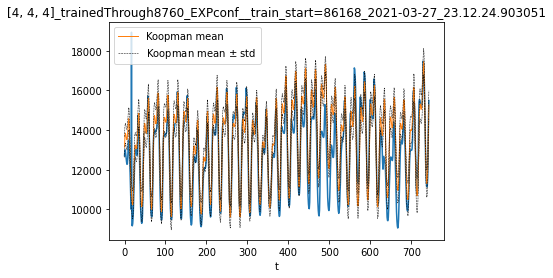

pinball_loss: 306.3698405983961
-16.880269479074972% performance relative to vanilla benchmark







In [14]:
for month, train_start in list(enumerate(train_starts))[::2]:
    print("TRAIN START:", train_start, "=", all_data[zone_name]["Date"][train_start])
    
    x = data[train_start:]
    x = x[:predict_through]
    xt = x[:train_through]
    mask = torch.ones(xt.shape, dtype=torch.uint8)
    mask[:pre_length] = 0
    num_freqs = [4, 4, 4]
    num_fourier = 4
    loss_weights = 1 + 0.4 * torch.cos(torch.linspace(-2 * np.pi * pre_length / (xt.shape[0] - pre_length), 2 * np.pi, xt.shape[0]))
    print("x", x.shape)
    print("xt", xt.shape)
    
    now = ("_".join(str(datetime.now()).split())).replace(":", ".")
    data_name = "EXPconf_" + f"_train_start={train_start}_" + now

    ### TRAIN ###
    model = AlternatingSkewNLL(x_dim=xt.shape[1], num_freqs=num_freqs, n=256)
    k = KoopmanProb(model, device='cpu', sample_num=24, num_fourier_modes=num_fourier, batch_size=32)
    
    k.find_fourier_omegas(xt, hard_code=[24, 168, 24 * 365.25 / 12, 24 * 365.24])
    
    k.fit(xt, iterations=600, verbose=False, cutoff=0, weight_decay=1e-3, lr_theta=1e-4, lr_omega=0, training_mask=mask);

    fname = "forecasts//" + data_name + f"trained{train_start}-{train_through}_{num_freqs}"
    mu_file = fname + "mu.npy"
    sigma_file = fname + "sigma.npy"
    alpha_file = fname + "alpha.npy"    

    ### FORECAST ###
    params = k.predict(predict_through)
    mu_hat, sigma_hat, a_hat = params
    
    mean_hat = model.mean(params)
    std_hat = model.std(params)
    
    # ADD TO CORRECT BIAS                                                    
    adjust = np.mean((xt[pre_length:] - mean_hat[pre_length:train_through]) / std_hat[pre_length:train_through]) / (np.mean(1 / std_hat[pre_length:train_through]))
    mu_hat += adjust
    np.save(mu_file, mu_hat)
    np.save(sigma_file, sigma_hat)
    np.save(alpha_file, a_hat)

    mean_hat = model.mean(params)
    std_hat = model.std(params)

    dim = 0
    plt.figure()
    # plt.scatter(np.arange(-slc), x[slc:], label="data")
    plt.plot(x[:predict_through, dim], label="data")
    plt.plot(mean_hat[:, dim], label="Koopman mean", linewidth=1)
    plt.plot(mean_hat[:, dim] + std_hat[:, dim], "--", color="black", label="Koopman mean $\pm$ std", linewidth=0.5)
    plt.plot(mean_hat[:, dim] - std_hat[:, dim], "--", color="black", linewidth=0.5)
    #plt.plot(a_hat[:, dim], color="red", linewidth=0.3, label="Koopman $\\alpha$")
    #plt.plot(std_hat[:, dim], color="green", linewidth=0.7, label="Koopman std")

    plt.title(f"{num_freqs}_trainedThrough{train_through}_" + data_name)
    plt.xlabel("t")
    plt.legend()
    plt.show()

    ### ANALYTICS ###
    print("actual overall mean:", 0, " predicted mean:", np.mean(mean_hat[:train_through]))

    z_scores.append((x[:train_through] - mean_hat[:train_through]) / std_hat[:train_through])
    test_z_scores.append(
        (x[train_through + delay:predict_through] - mean_hat[train_through + delay:predict_through]) 
         / std_hat[train_through + delay:predict_through])

    ### PERFORMANCE ###

    #Skew-Normal distribution Rescaling to de-normalize data because pinball loss is not scale-invariant
    test_start = train_through + delay
    sigh, ah = sigma_hat[test_start: predict_through], a_hat[test_start: predict_through]
    delta = ah / (1 + ah ** 2) ** 0.5
    muh = mu_hat[test_start: predict_through] * rnge + (rnge - 1) * delta * sigh * (2 / np.pi) ** 0.5
    muh = muh + mean - (rnge - 1) * delta * sigh * (2 / np.pi) ** 0.5
    sigh = sigh * rnge
    mean_hat = model.mean([muh, sigh, ah])
    std_hat = model.std([muh, sigh, ah])

    plt.figure()
    plt.plot(x_original[train_start:][test_start: predict_through])
    plt.plot(mean_hat[:, dim], label="Koopman mean", linewidth=1)
    plt.plot(mean_hat[:, dim] + std_hat[:, dim], "--", color="black", label="Koopman mean $\pm$ std", linewidth=0.5)
    plt.plot(mean_hat[:, dim] - std_hat[:, dim], "--", color="black", linewidth=0.5)
    # plt.plot(ah[:, dim], color="red", linewidth=0.3, label="Koopman $\\alpha$")
    # plt.plot(std_hat[:, dim], color="green", linewidth=0.7, label="Koopman std")
    plt.title(f"{num_freqs}_trainedThrough{train_through}_" + data_name)
    plt.xlabel("t")
    plt.legend()
    plt.show()

    loss = skew_pinball_loss(x_original[train_start:][test_start: predict_through], muh, sigh, ah)[0]
    relative = (1 - loss/vanilla_losses[month]) * 100
    print("pinball_loss:", loss)
    print(f"{relative}% performance relative to vanilla benchmark" + "\n"*5)
    losses.append(loss)
    relative_perfs.append(relative)

# Figures

In [15]:
# for tables
for loss in losses[:6]:
    print(np.round(loss, 1), end="\t")
print("")
for rel in relative_perfs[:6]:
    print(np.round(rel, 1), end="%\t")

334.5	203.7	364.1	428.4	456.1	306.4	
15.9%	38.1%	-12.5%	21.4%	20.0%	-16.9%	

In [16]:
idx = 6
for z_score in z_scores[:idx]:
    print(np.round(np.mean(z_score), 2), end="\t")
print()
for z_score in z_scores[:idx]:
    print(np.round(np.std(z_score), 2), end="\t")
print()
for z_score in z_scores[:idx]:
    print(np.round(skew(z_score)[0], 2), end="\t")
print()
for z_score in test_z_scores[:idx]:
    print(np.round(np.mean(z_score), 2), end="\t")
print()
for z_score in test_z_scores[:idx]:
    print(np.round(np.std(z_score), 2), end="\t")
print()
for z_score in test_z_scores[:idx]:
    print(np.round(skew(z_score)[0], 2), end="\t")

0.0	0.0	-0.0	0.0	0.0	0.0	
0.99	0.97	0.98	1.0	0.97	0.99	
0.46	0.32	0.45	0.6	0.49	0.55	
-0.06	-0.32	0.83	0.36	0.59	-1.11	
1.11	1.19	2.19	1.41	1.59	1.59	
-0.0	0.07	0.68	1.38	1.14	0.02	

mean of z-scores in month Jan: 2.688839329414246e-08 std of z-scores: 0.9919196258480125
mean of z-scores in month Mar: 5.224359056456835e-08 std of z-scores: 0.9682670033409516
mean of z-scores in month May: -1.7967078910204105e-08 std of z-scores: 0.9776994399238182
mean of z-scores in month Jul: 2.261790008455257e-08 std of z-scores: 0.9973994058358003
mean of z-scores in month Sep: 3.449760717048578e-08 std of z-scores: 0.9744145001500114
mean of z-scores in month Nov: 4.7541675816200824e-08 std of z-scores: 0.9935732984312712


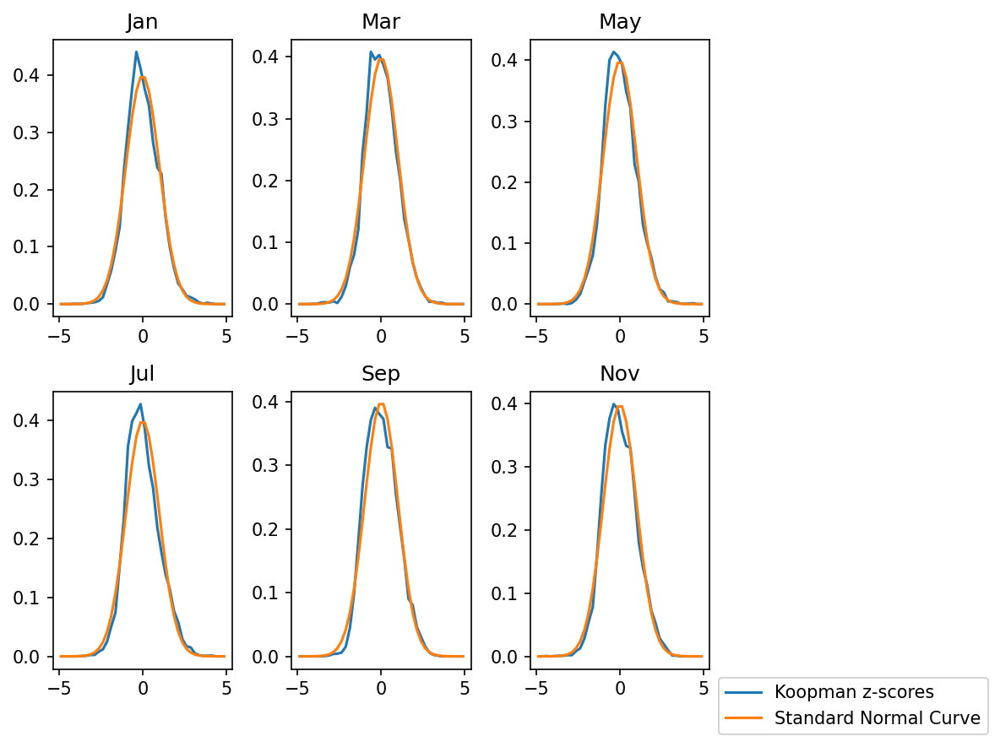

In [17]:
%matplotlib inline
z_hists = []
plt.subplots(dpi=150, figsize=(8, 6))
for i, z_score in enumerate(z_scores):
    month = 2*i
    z_hist, bin_edges = np.histogram(z_score, bins=40, range=(-5, 5), density=True)
    z_hists.append(z_hist)
    z_axis = (bin_edges[1:] + bin_edges[:-1]) / 2
    print(f"mean of z-scores in month {months[month]}:", np.mean(z_score), "std of z-scores:", np.std(z_score))
    
    plt.subplot(2, 3, i + 1)
    plt.plot(z_axis, z_hist, label="Koopman z-scores")
    plt.plot(z_axis, normal_pdf(0, 1, z_axis), label="Standard Normal Curve")
    plt.title(months[month])
#     plt.xlabel("z")
plt.legend(loc="upper left", bbox_to_anchor=(1, 0))
plt.tight_layout()
plt.show()

mean of z-scores in month 0: -0.05699946054067406 std of z-scores: 1.1083233537603392
mean of z-scores in month 2: -0.3169789834134395 std of z-scores: 1.1904488397849267
mean of z-scores in month 4: 0.8296055928624667 std of z-scores: 2.189649016736693
mean of z-scores in month 6: 0.3621871298851202 std of z-scores: 1.4059219288166582
mean of z-scores in month 8: 0.5858817328736797 std of z-scores: 1.594969468925893
mean of z-scores in month 10: -1.108478014070822 std of z-scores: 1.5920217251321238


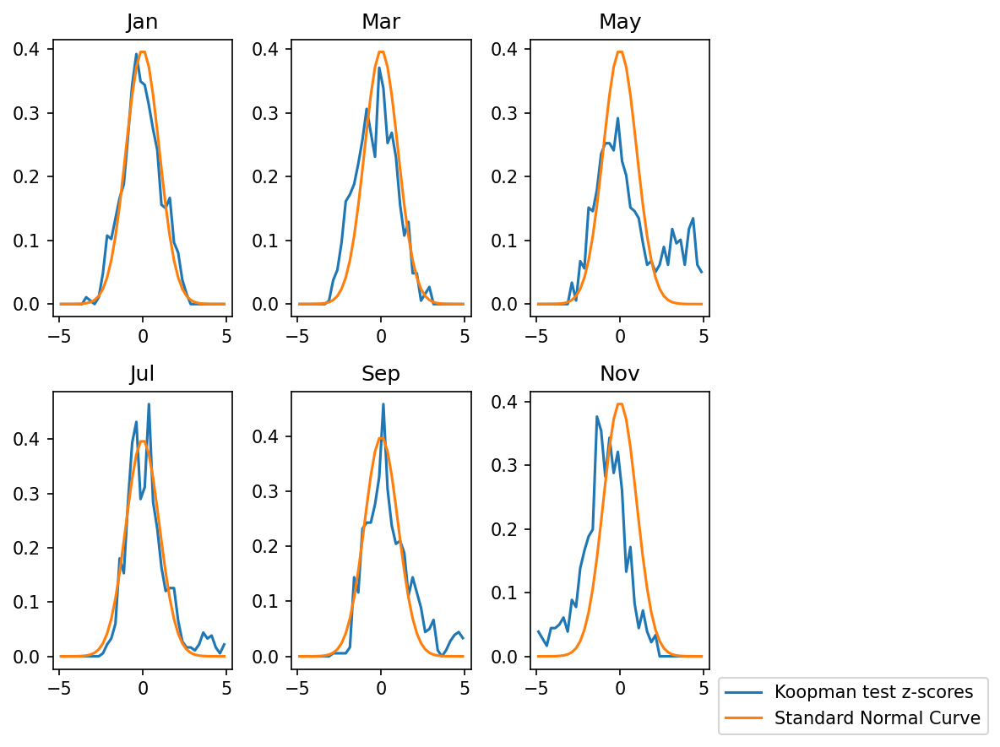

In [18]:
%matplotlib inline
test_z_hists = []
plt.subplots(dpi=150, figsize=(8, 6))
for i, z_score in enumerate(test_z_scores):
    month = 2 * i
    z_hist, bin_edges = np.histogram(z_score, bins=40, range=(-5, 5), density=True)
    test_z_hists.append(z_hist)
    z_axis = (bin_edges[1:] + bin_edges[:-1]) / 2
    print(f"mean of z-scores in month {month}:", np.mean(z_score), "std of z-scores:", np.std(z_score))
    
    plt.subplot(2, 3, i + 1)
    plt.plot(z_axis, z_hist, label="Koopman test z-scores")
    plt.plot(z_axis, normal_pdf(0, 1, z_axis), label="Standard Normal Curve")
    plt.title(months[month])
#     plt.xlabel("z")
plt.legend(loc="upper left", bbox_to_anchor=(1, 0))
plt.tight_layout()
plt.show()

In [20]:
z_scores = np.array(z_scores)
test_z_scores = np.array(test_z_scores)
losses = np.array(losses)
relative = np.array(relative_perfs)

In [21]:
np.save("experiments\\" + data_name + "z_scores.npy", z_scores)
np.save("experiments\\" + data_name + "test_z_scores.npy", test_z_scores)
np.save("experiments\\" + data_name + "relative_perfs.npy", relative_perfs)
np.save("experiments\\" + data_name + "losses.npy", losses)

# Finding optimal number of iterations

In [ ]:
x = data[train_start:]
x = x[:predict_through]
xt = x[:train_through]
mask = torch.ones(xt.shape, dtype=torch.uint8)
mask[:pre_length] = 0
num_freqs = [4, 4, 4]
num_fourier = 4
loss_weights = 1 + 0.4 * torch.cos(torch.linspace(-2 * np.pi * pre_length / (xt.shape[0] - pre_length), 2 * np.pi, xt.shape[0]))
print("x", x.shape)
print("xt", xt.shape)

now = ("_".join(str(datetime.now()).split())).replace(":", ".")
data_name = "EXPconf_" + f"_train_start={train_start}_" + now

### TRAIN ###
model = AlternatingSkewNLL(x_dim=xt.shape[1], num_freqs=num_freqs, n=256)
k = KoopmanProb(model, device='cpu', sample_num=24, num_fourier_modes=num_fourier, batch_size=32)

k.find_fourier_omegas(xt, hard_code=[24, 168, 24 * 365.25 / 12, 24 * 365.24])

In [ ]:
k.fit(xt, iterations=600, verbose=False, cutoff=0, weight_decay=1e-3, lr_theta=1e-4, lr_omega=0, training_mask=mask);

fname = "forecasts//" + data_name + f"trained{train_start}-{train_through}_{num_freqs}"
mu_file = fname + "mu.npy"
sigma_file = fname + "sigma.npy"
alpha_file = fname + "alpha.npy"    

### FORECAST ###
params = k.predict(predict_through)
mu_hat, sigma_hat, a_hat = params

mean_hat = model.mean(params)
std_hat = model.std(params)

# ADD TO CORRECT BIAS                                                    
adjust = np.mean((xt[pre_length:] - mean_hat[pre_length:train_through]) / std_hat[pre_length:train_through]) / (np.mean(1 / std_hat[pre_length:train_through]))
mu_hat += adjust
np.save(mu_file, mu_hat)
np.save(sigma_file, sigma_hat)
np.save(alpha_file, a_hat)

mean_hat = model.mean(params)
std_hat = model.std(params)

dim = 0
plt.figure()
# plt.scatter(np.arange(-slc), x[slc:], label="data")
plt.plot(x[:predict_through, dim], label="data")
plt.plot(mean_hat[:, dim], label="Koopman mean", linewidth=1)
plt.plot(mean_hat[:, dim] + std_hat[:, dim], "--", color="black", label="Koopman mean $\pm$ std", linewidth=0.5)
plt.plot(mean_hat[:, dim] - std_hat[:, dim], "--", color="black", linewidth=0.5)
#plt.plot(a_hat[:, dim], color="red", linewidth=0.3, label="Koopman $\\alpha$")
#plt.plot(std_hat[:, dim], color="green", linewidth=0.7, label="Koopman std")

plt.title(f"{num_freqs}_trainedThrough{train_through}_" + data_name)
plt.xlabel("t")
plt.legend()
plt.show()

### ANALYTICS ###
print("actual overall mean:", 0, " predicted mean:", np.mean(mean_hat[:train_through]))

z_scores.append((x[:train_through] - mean_hat[:train_through]) / std_hat[:train_through])
test_z_scores.append(
    (x[train_through + delay:predict_through] - mean_hat[train_through + delay:predict_through]) 
     / std_hat[train_through + delay:predict_through])

### PERFORMANCE ###

#Skew-Normal distribution Rescaling to de-normalize data because pinball loss is not scale-invariant
test_start = train_through + delay
sigh, ah = sigma_hat[test_start: predict_through], a_hat[test_start: predict_through]
delta = ah / (1 + ah ** 2) ** 0.5
muh = mu_hat[test_start: predict_through] * rnge + (rnge - 1) * delta * sigh * (2 / np.pi) ** 0.5
muh = muh + mean - (rnge - 1) * delta * sigh * (2 / np.pi) ** 0.5
sigh = sigh * rnge
mean_hat = model.mean([muh, sigh, ah])
std_hat = model.std([muh, sigh, ah])

plt.figure()
plt.plot(x_original[train_start:][test_start: predict_through])
plt.plot(mean_hat[:, dim], label="Koopman mean", linewidth=1)
plt.plot(mean_hat[:, dim] + std_hat[:, dim], "--", color="black", label="Koopman mean $\pm$ std", linewidth=0.5)
plt.plot(mean_hat[:, dim] - std_hat[:, dim], "--", color="black", linewidth=0.5)
# plt.plot(ah[:, dim], color="red", linewidth=0.3, label="Koopman $\\alpha$")
# plt.plot(std_hat[:, dim], color="green", linewidth=0.7, label="Koopman std")
plt.title(f"{num_freqs}_trainedThrough{train_through}_" + data_name)
plt.xlabel("t")
plt.legend()
plt.show()

loss = skew_pinball_loss(x_original[train_start:][test_start: predict_through], muh, sigh, ah)[0]
relative = (1 - loss/vanilla_losses[month]) * 100
print("pinball_loss:", loss)
print(f"{relative}% performance relative to vanilla benchmark" + "\n"*5)
losses.append(loss)
relative_perfs.append(relative)

In [34]:
T = 100
weights = 1 + 0.4 * torch.cos(torch.linspace(0, 11 * 2 * np.pi, T))
weights *= 1/(1 + torch.exp((3*T / 4 - torch.arange(T)) / (T / 10))) + 0.5
weights[:T//2] = 1

(0.0, 2.5)

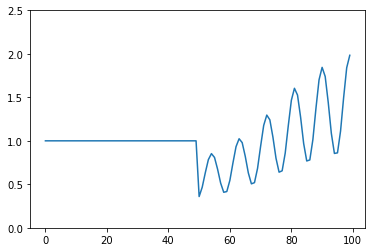

In [36]:
plt.plot(weights)
plt.ylim([0, 2.5])

In [38]:
weights[T//2:].mean()

tensor(0.9974)